In [5]:
ls

domain/          make_data.ipynb


In [2]:
import os
import shutil
from collections import defaultdict
import numpy as np

# Define the base directory containing the domains
base_dir = "./domain"  # Update to match your folder structure

# Step 1: Count images for each class across all domains
class_counts = defaultdict(lambda: defaultdict(int))  # {class_name: {domain: count}}

# List all domains
domains = [d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))]
print(domains)

for domain in domains:
    domain_path = os.path.join(base_dir, domain)  # Path like real/real, sketch/sketch, etc.
    if not os.path.exists(domain_path):
        continue  # Skip if the domain path does not exist
    
    # List all class folders in the current domain
    class_folders = [f for f in os.listdir(domain_path) if os.path.isdir(os.path.join(domain_path, f))]
    
    for class_folder in class_folders:
        class_path = os.path.join(domain_path, class_folder)
        # Count the number of images in the class folder
        num_images = len([f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))])
        class_counts[class_folder][domain] += num_images

# Step 2: Filter classes based on a minimum count per class per domain
min_count_per_class_per_domain = 50  # Set the minimum number of images required per class per domain
valid_classes = []

for class_name, domain_counts in class_counts.items():
    # Check if each domain meets the minimum image count for this class
    if all(domain_counts.get(domain, 0) >= min_count_per_class_per_domain for domain in domains):
        valid_classes.append(class_name)

# Step 3: Calculate variation for valid classes and select the top 100
class_variation = []

for class_name in valid_classes:
    domain_counts = class_counts[class_name]
    counts = [domain_counts.get(domain, 0) for domain in domains]
    # Calculate variation (standard deviation)
    variation = np.std(counts)
    class_variation.append((class_name, variation))

# Sort classes by least variation and select the top 100
class_variation.sort(key=lambda x: x[1])  # Sort by variation (ascending)
top_classes = [x[0] for x in class_variation[:30]]




['infograph', 'quickdraw', 'real', 'painting', 'sketch', 'clipart']


In [3]:
print("Top 100 classes with least variation:")
print(len(top_classes))
print(top_classes)

Top 100 classes with least variation:
30
['feather', 'triangle', 'circle', 'tiger', 'suitcase', 'strawberry', 'grass', 'flower', 'umbrella', 'tornado', 'whale', 'bee', 'yoga', 'The_Mona_Lisa', 'basketball', 'barn', 'cloud', 'sailboat', 'soccer_ball', 'skyscraper', 'shark', 'windmill', 'hockey_stick', 'stethoscope', 'trombone', 'fish', 'violin', 'hourglass', 'trumpet', 'birthday_cake']


In [4]:
# Calculate the total number of images for each domain with the chosen classes
domain_totals = defaultdict(int)

for class_name in top_classes:
    for domain in domains:
        domain_totals[domain] += class_counts[class_name][domain]

# Print the total number of images for each domain
print("Total number of images per domain with chosen classes:")
for domain, total in domain_totals.items():
    print(f"{domain}: {total} images")


Total number of images per domain with chosen classes:
infograph: 7372 images
quickdraw: 15000 images
real: 12035 images
painting: 8793 images
sketch: 7683 images
clipart: 5965 images


In [5]:
# Calculate the total number of images for each domain with the chosen classes
domain_totals = defaultdict(int)

for class_name in top_classes:
    for domain in domains:
        domain_totals[domain] += class_counts[class_name][domain]

# Print the total number of images for each domain
print("Total number of images per domain with chosen classes:")
for domain, total in domain_totals.items():
    print(f"{domain}: {total} images")


Total number of images per domain with chosen classes:
infograph: 7372 images
quickdraw: 15000 images
real: 12035 images
painting: 8793 images
sketch: 7683 images
clipart: 5965 images


In [6]:
# Step 4: Remove classes not in the top 100
for domain in domains:
    domain_path = os.path.join(base_dir, domain, )
    if not os.path.exists(domain_path):
        continue
    
    class_folders = [f for f in os.listdir(domain_path) if os.path.isdir(os.path.join(domain_path, f))]
    
    for class_folder in class_folders:
        if class_folder not in top_classes:
            # Remove this class folder
            class_path = os.path.join(domain_path, class_folder)
            print(f"Removing {class_path}")
            shutil.rmtree(class_path)

print("Cleanup completed. Retained top 100 classes with sufficient images per domain and least variation.")





Removing ./domain/infograph/lollipop
Removing ./domain/infograph/apple
Removing ./domain/infograph/diamond
Removing ./domain/infograph/helmet
Removing ./domain/infograph/skull
Removing ./domain/infograph/palm_tree
Removing ./domain/infograph/lipstick
Removing ./domain/infograph/cat
Removing ./domain/infograph/rhinoceros
Removing ./domain/infograph/peanut
Removing ./domain/infograph/animal_migration
Removing ./domain/infograph/pond
Removing ./domain/infograph/ant
Removing ./domain/infograph/fire_hydrant
Removing ./domain/infograph/jacket
Removing ./domain/infograph/blueberry
Removing ./domain/infograph/microwave
Removing ./domain/infograph/remote_control
Removing ./domain/infograph/tree
Removing ./domain/infograph/paintbrush
Removing ./domain/infograph/butterfly
Removing ./domain/infograph/see_saw
Removing ./domain/infograph/crown
Removing ./domain/infograph/leaf
Removing ./domain/infograph/boomerang
Removing ./domain/infograph/drill
Removing ./domain/infograph/toaster
Removing ./domain

In [7]:
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from PIL import Image
from torch.utils.data import ConcatDataset
# Define a PyTorch dataset for loading images and labels
class ImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.images = []
        self.labels = []
        self.class_to_idx = {}

        # Gather all images and class labels
        for class_idx, class_folder in enumerate(sorted(os.listdir(root_dir))):
            class_path = os.path.join(root_dir, class_folder)
            if os.path.isdir(class_path):
                self.class_to_idx[class_folder] = class_idx
                for img_file in os.listdir(class_path):
                    img_path = os.path.join(class_path, img_file)
                    if os.path.isfile(img_path):
                        self.images.append(img_path)
                        self.labels.append(class_idx)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        label = self.labels[idx]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, label

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to 224x224 (VGG-16 input size)
    transforms.ToTensor()
])

# Combine all images from all domain folders into a single dataset


# Step 5.1: Create a dataset for each domain and combine them for the central DataLoader
all_datasets = []
for domain in domains:
    domain_path = os.path.join(base_dir, domain)  # real/real, sketch/sketch, etc.
    if os.path.exists(domain_path):
        domain_dataset = ImageDataset(domain_path, transform=transform)
        all_datasets.append(domain_dataset)

# Combine all domain datasets into one central dataset
central_dataset = ConcatDataset(all_datasets)
central_dataloader = DataLoader(central_dataset, batch_size=32, shuffle=True)

# Print central dataset size
print(f"Central DataLoader: {len(central_dataset)} images")


# Step 5.2: Create a DataLoader for each domain
domain_dataloaders = {}
for domain in domains:
    domain_path = os.path.join(base_dir, domain)  # Path to the domain folder
    if os.path.exists(domain_path):
        domain_dataset = ImageDataset(domain_path, transform=transform)
        domain_dataloader = DataLoader(domain_dataset, batch_size=32, shuffle=True)
        domain_dataloaders[domain] = domain_dataloader

# Example: Accessing data from the central and domain-specific dataloaders
print(f"Central DataLoader: {len(central_dataset)} images")
for domain, loader in domain_dataloaders.items():
    print(f"{domain} DataLoader: {len(loader.dataset)} images")


Central DataLoader: 56848 images
Central DataLoader: 56848 images
infograph DataLoader: 7372 images
quickdraw DataLoader: 15000 images
real DataLoader: 12035 images
painting DataLoader: 8793 images
sketch DataLoader: 7683 images
clipart DataLoader: 5965 images


In [8]:
import pickle

# Save the dataset for the central DataLoader
def save_dataset(dataset, file_path):
    data = {
        "images": dataset.images,
        "labels": dataset.labels,
        "class_to_idx": dataset.class_to_idx
    }
    with open(file_path, "wb") as f:
        pickle.dump(data, f)
    print(f"Dataset saved to {file_path}")

# Save central dataset
save_dataset(central_dataset.datasets[0], "central_dataset.pkl")  # Use central_dataset.datasets[0] for ConcatDataset

# Save domain-specific datasets
for domain, dataloader in domain_dataloaders.items():
    domain_file = f"{domain}_dataset.pkl"
    save_dataset(dataloader.dataset, domain_file)


Dataset saved to central_dataset.pkl
Dataset saved to infograph_dataset.pkl
Dataset saved to quickdraw_dataset.pkl
Dataset saved to real_dataset.pkl
Dataset saved to painting_dataset.pkl
Dataset saved to sketch_dataset.pkl
Dataset saved to clipart_dataset.pkl


In [3]:
import os
from PIL import Image

def compress_images(input_dir, output_dir, target_size=(224, 224), quality=85):
    """
    Compress and resize images in the input directory, saving them to the output directory.

    Args:
        input_dir (str): Directory containing original images.
        output_dir (str): Directory to save compressed images.
        target_size (tuple): New dimensions for the images (width, height).
        quality (int): Compression quality (1-100, higher is better quality).
    """
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Iterate through all files in the input directory
    for root, _, files in os.walk(input_dir):
        for file in files:
            if file.endswith(('.jpg', '.jpeg', '.png')):
                input_path = os.path.join(root, file)
                relative_path = os.path.relpath(input_path, input_dir)
                output_path = os.path.join(output_dir, relative_path)

                # Create subdirectories in the output directory
                os.makedirs(os.path.dirname(output_path), exist_ok=True)

                # Open and process the image
                with Image.open(input_path) as img:
                    img = img.convert("RGB")  # Ensure all images are in RGB format
                    img = img.resize(target_size, Image.Resampling.LANCZOS)  # Resize image
                    img.save(output_path, format="JPEG", quality=quality)  # Save compressed image

                print(f"Compressed and saved: {output_path}")

# Example usage
compress_images(
    input_dir="./domains",  # Replace with your original image directory
    output_dir="./compressed_domains",  # Replace with your desired output directory
    target_size=(224, 224),  # Resize images to 224x224
    quality=50  # Adjust quality (85 is a good balance between size and quality)
)



Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000001.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000002.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000003.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000004.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000005.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000006.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000007.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000008.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000009.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000010.jpg
Compressed and saved: ./compressed_domains\clipart\clipart\airplane\clipart_002_000011.jpg

In [1]:
ls

domain/          make_data.ipynb


In [2]:
import os
import shutil
from collections import defaultdict
import numpy as np
from torch.utils.data import ConcatDataset, DataLoader, Dataset
from torchvision import transforms
from PIL import Image

# Define the base directory containing the domains
base_dir = "./domain"

# Step 1: Count images for each class across all domains
class_counts = defaultdict(lambda: defaultdict(int))  # {class_name: {domain: count}}

# List all domains
domains = [d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))]

for domain in domains:
    domain_path = os.path.join(base_dir, domain)  # Adjusted path
    if not os.path.exists(domain_path):
        continue  # Skip if the domain path does not exist

    # List all class folders in the current domain
    class_folders = [f for f in os.listdir(domain_path) if os.path.isdir(os.path.join(domain_path, f))]
    
    for class_folder in class_folders:
        class_path = os.path.join(domain_path, class_folder)
        # Count the number of images in the class folder
        num_images = len([f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))])
        class_counts[class_folder][domain] += num_images

# Step 2: Filter classes based on a minimum count per class per domain
min_count_per_class_per_domain = 50  # Set the minimum number of images required per class per domain
valid_classes = []

for class_name, domain_counts in class_counts.items():
    # Check if each domain meets the minimum image count for this class
    if all(domain_counts.get(domain, 0) >= min_count_per_class_per_domain for domain in domains):
        valid_classes.append(class_name)

# Step 3: Calculate variation for valid classes and select the top 10
class_variation = []

if valid_classes:  # Check if there are valid classes
    for class_name in valid_classes:
        domain_counts = class_counts[class_name]
        counts = [domain_counts.get(domain, 0) for domain in domains]
        # Calculate variation (standard deviation)
        variation = np.std(counts)
        class_variation.append((class_name, variation))

    # Sort classes by least variation and select the top 10
    class_variation.sort(key=lambda x: x[1])  # Sort by variation (ascending)
    top_classes = [x[0] for x in class_variation[:20]]  # Select top 10 classes
else:
    print("No valid classes meet the criteria. Adjust the filtering parameters.")
    top_classes = []

print("Top 10 classes with least variation:")
print(len(top_classes))
print(top_classes)

# Check if there are top classes before proceeding
if top_classes:
    # Step 4: Remove classes not in the top 10
    for domain in domains:
        domain_path = os.path.join(base_dir, domain)  # Adjusted path
        if not os.path.exists(domain_path):
            continue
        
        class_folders = [f for f in os.listdir(domain_path) if os.path.isdir(os.path.join(domain_path, f))]
        
        for class_folder in class_folders:
            if class_folder not in top_classes:
                # Remove this class folder
                class_path = os.path.join(domain_path, class_folder)
                if os.path.exists(class_path):  # Ensure folder exists
                    print(f"Removing {class_path}")
                    shutil.rmtree(class_path)

    print("Cleanup completed. Retained top 10 classes with all images per domain.")

    # Step 5: Define PyTorch Dataset
    class ImageDataset(Dataset):
        def __init__(self, root_dir, transform=None):
            self.root_dir = root_dir
            self.transform = transform
            self.images = []
            self.labels = []
            self.class_to_idx = {}

            # Gather all images and class labels
            for class_idx, class_folder in enumerate(sorted(os.listdir(root_dir))):
                class_path = os.path.join(root_dir, class_folder)
                if os.path.isdir(class_path):
                    self.class_to_idx[class_folder] = class_idx
                    for img_file in os.listdir(class_path):
                        img_path = os.path.join(class_path, img_file)
                        if os.path.isfile(img_path):
                            self.images.append(img_path)
                            self.labels.append(class_idx)

        def __len__(self):
            return len(self.images)

        def __getitem__(self, idx):
            img_path = self.images[idx]
            label = self.labels[idx]
            image = Image.open(img_path).convert("RGB")
            if self.transform:
                image = self.transform(image)
            return image, label

    # Define transformations
    transform = transforms.Compose([
        transforms.Resize((224, 224)),  # Resize images to 224x224
        transforms.ToTensor()
    ])

    # Step 5.1: Create a dataset for each domain and combine them for the central DataLoader
    all_datasets = []
    for domain in domains:
        domain_path = os.path.join(base_dir, domain)
        if os.path.exists(domain_path):
            domain_dataset = ImageDataset(domain_path, transform=transform)
            all_datasets.append(domain_dataset)

    if all_datasets:  # Check if there are any datasets to combine
        # Combine all domain datasets into one central dataset
        central_dataset = ConcatDataset(all_datasets)
        central_dataloader = DataLoader(central_dataset, batch_size=32, shuffle=True)

        # Print central dataset size
        print(f"Central DataLoader: {len(central_dataset)} images")

    # Step 5.2: Create a DataLoader for each domain
    domain_dataloaders = {}
    for domain in domains:
        domain_path = os.path.join(base_dir, domain)  # Path to the domain folder
        if os.path.exists(domain_path):
            domain_dataset = ImageDataset(domain_path, transform=transform)
            domain_dataloader = DataLoader(domain_dataset, batch_size=32, shuffle=True)
            domain_dataloaders[domain] = domain_dataloader

    # Example: Accessing data from the central and domain-specific dataloaders
    if all_datasets:
        print(f"Central DataLoader: {len(central_dataset)} images")
    for domain, loader in domain_dataloaders.items():
        print(f"{domain} DataLoader: {len(loader.dataset)} images")
else:
    print("No top classes found. No datasets created.")

# import pickle

# # Save the dataset for the central DataLoader
# def save_dataset(dataset, file_path):
#     data = {
#         "images": dataset.images,
#         "labels": dataset.labels,
#         "class_to_idx": dataset.class_to_idx
#     }
#     with open(file_path, "wb") as f:
#         pickle.dump(data, f)
#     print(f"Dataset saved to {file_path}")
#     print(f"Number of images: {len(data['images'])}")

# # Save central dataset
# save_dataset(central_dataset.datasets[0], "central_dataset.pkl")

# # Save domain-specific datasets
# for domain, dataloader in domain_dataloaders.items():
#     domain_file = f"{domain}_dataset.pkl"
#     save_dataset(dataloader.dataset, domain_file)




Top 10 classes with least variation:
20
['basketball', 'key', 'barn', 'picture_frame', 'sailboat', 'sun', 'strawberry', 'tornado', 'The_Mona_Lisa', 'shark', 'fish', 'teddy-bear', 'baseball_bat', 'The_Eiffel_Tower', 'star', 'stop_sign', 'teapot', 'fork', 'basket', 'tree']
Removing ./domain/infograph/lollipop
Removing ./domain/infograph/apple
Removing ./domain/infograph/diamond
Removing ./domain/infograph/helmet
Removing ./domain/infograph/skull
Removing ./domain/infograph/palm_tree
Removing ./domain/infograph/lipstick
Removing ./domain/infograph/cat
Removing ./domain/infograph/rhinoceros
Removing ./domain/infograph/peanut
Removing ./domain/infograph/animal_migration
Removing ./domain/infograph/pond
Removing ./domain/infograph/ant
Removing ./domain/infograph/fire_hydrant
Removing ./domain/infograph/jacket
Removing ./domain/infograph/blueberry
Removing ./domain/infograph/microwave
Removing ./domain/infograph/remote_control
Removing ./domain/infograph/paintbrush
Removing ./domain/infograph

In [37]:
# Save central dataset
save_dataset(central_dataset.datasets[0], "central_dataset.pkl")


Dataset saved to central_dataset.pkl


In [39]:
print(domain_dataloaders)

{}


In [38]:

# Save domain-specific datasets
for domain, dataloader in domain_dataloaders.items():
    domain_file = f"{domain}_dataset.pkl"
    save_dataset(dataloader.dataset, domain_file)


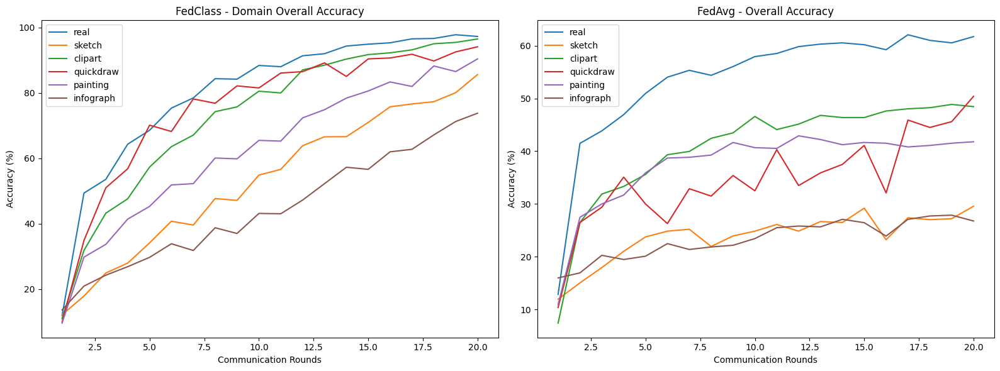

In [9]:
import matplotlib.pyplot as plt
import numpy as np

# Data for fedclass (domain overall)
fedclass_data = {
    "real": [11.98581560283688, 49.385342789598106, 53.593380614657214, 64.32624113475177, 68.58156028368795, 75.36643026004728, 78.46335697399527, 84.34988179669031, 84.20803782505911, 88.39243498817967, 88.01418439716312, 91.34751773049645, 91.98581560283688, 94.32624113475177, 94.8936170212766, 95.31914893617021, 96.52482269503547, 96.64302600472813, 97.77777777777777, 97.25768321513003],
    "sketch": [12.213740458015268, 17.92075608869502, 24.972737186477644, 27.989821882951652, 34.1693929480189, 40.785169029443836, 39.62195565249, 47.72809887313704, 47.146492184660126, 54.88913122500909, 56.63395129043984, 63.8676844783715, 66.59396583060705, 66.63031624863686, 70.99236641221374, 75.7542711741185, 76.62668120683388, 77.31733914940021, 80.07997091966557, 85.60523446019629],
    "clipart": [11.060480530240266, 31.897265948632974, 43.24772162386081, 47.63877381938691, 57.33222866611433, 63.587406793703394, 67.10853355426677, 74.27506213753107, 75.72493786246893, 80.53024026512013, 79.99171499585749, 87.03396851698426, 88.48384424192213, 90.34797017398509, 91.71499585749793, 92.25352112676056, 93.1648715824358, 95.02899751449876, 95.44324772162386, 96.47887323943662],
    "quickdraw": [10.0, 34.9, 51.02, 56.82, 70.14, 68.22, 78.16, 76.84, 82.16, 81.52, 86.08, 86.5, 89.18, 85.04, 90.4, 90.68, 91.82, 89.76, 92.54, 94.1],
    "painting": [9.65749578888265, 29.814710836608647, 33.7170129140932, 41.43739472206625, 45.31162268388546, 51.88096574957889, 52.27400336889388, 60.106681639528354, 59.85401459854015, 65.4969118472768, 65.27231892195395, 72.37507018528916, 74.8736664795059, 78.41100505334082, 80.60078607523863, 83.35204941044357, 81.97641774284111, 88.23694553621561, 86.52442448062887, 90.39865244244807],
    "infograph": [13.701236917221694, 20.964161116397083, 24.294322867110687, 26.895020615287027, 29.749444973041548, 33.90421820488424, 31.84268950206153, 38.78845543926419, 37.044084998414206, 43.16523945448779, 43.07009197589597, 47.25658103393594, 52.26768157310498, 57.27878211227402, 56.64446558832858, 62.00444021566762, 62.765620044402155, 67.17411988582303, 71.26546146527117, 73.80272756105296]
}

# Data for fedavg
fedavg_data = {
    "real": [12.884160756501181, 41.48936170212766, 43.853427895981085, 46.92671394799054, 50.945626477541374, 54.018912529550825, 55.319148936170215, 54.37352245862884, 56.02836879432624, 57.91962174940898, 58.51063829787234, 59.810874704491724, 60.283687943262414, 60.520094562647756, 60.16548463356974, 59.219858156028366, 62.05673758865248, 60.99290780141844, 60.520094562647756, 61.702127659574465],
    "sketch": [11.978221415607985, 15.063520871143377, 17.96733212341198, 21.05263157894737, 23.77495462794918, 24.86388384754991, 25.226860254083483, 21.960072595281307, 23.95644283121597, 24.86388384754991, 26.134301270417424, 24.86388384754991, 26.678765880217785, 26.497277676950997, 29.219600725952812, 23.23049001814882, 27.404718693284938, 27.04174228675136, 27.22323049001815, 29.58257713248639],
    "clipart": [7.453416149068323, 26.501035196687372, 31.884057971014492, 33.333333333333336, 35.61076604554865, 39.33747412008282, 39.958592132505174, 42.44306418219462, 43.47826086956522, 46.58385093167702, 44.099378881987576, 45.13457556935818, 46.79089026915114, 46.3768115942029, 46.3768115942029, 47.61904761904762, 48.033126293995856, 48.24016563146998, 48.86128364389234, 48.4472049689441],
    "quickdraw": [10.4, 26.5, 29.4, 35.1, 30.0, 26.3, 32.9, 31.5, 35.4, 32.5, 40.3, 33.5, 35.9, 37.5, 41.1, 32.1, 45.9, 44.5, 45.6, 50.4],
    "painting": [10.93969144460028, 27.489481065918653, 30.014025245441797, 31.697054698457222, 35.90462833099579, 38.70967741935484, 38.849929873772794, 39.27068723702665, 41.654978962131835, 40.67321178120617, 40.532959326788216, 42.91725105189341, 42.215988779803645, 41.23422159887798, 41.654978962131835, 41.51472650771389, 40.813464235624124, 41.093969144460026, 41.51472650771389, 41.79523141654979],
    "infograph": [16.00633914421553, 16.957210776545168, 20.28526148969889, 19.492868462757528, 20.126782884310618, 22.503961965134707, 21.394611727416798, 21.870047543581617, 22.18700475435816, 23.454833597464344, 25.515055467511885, 25.832012678288432, 25.673534072900157, 27.099841521394612, 26.465927099841522, 23.93026941362916, 27.099841521394612, 27.733755942947703, 27.892234548335974, 26.782884310618066]
}

rounds = np.arange(1, 21)

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharex=True)

# Plot for fedclass (domain overall)
for domain, values in fedclass_data.items():
    axes[0].plot(rounds, values, label=domain)
axes[0].set_title('FedClass - Domain Overall Accuracy')
axes[0].set_xlabel('Communication Rounds')
axes[0].set_ylabel('Accuracy (%)')
axes[0].legend()

# Plot for fedavg (overall accuracy)
for domain, values in fedavg_data.items():
    axes[1].plot(rounds, values, label=domain)
axes[1].set_title('FedAvg - Overall Accuracy')
axes[1].set_xlabel('Communication Rounds')
axes[1].set_ylabel('Accuracy (%)')
axes[1].legend()

# Show plots
plt.tight_layout()
plt.show()


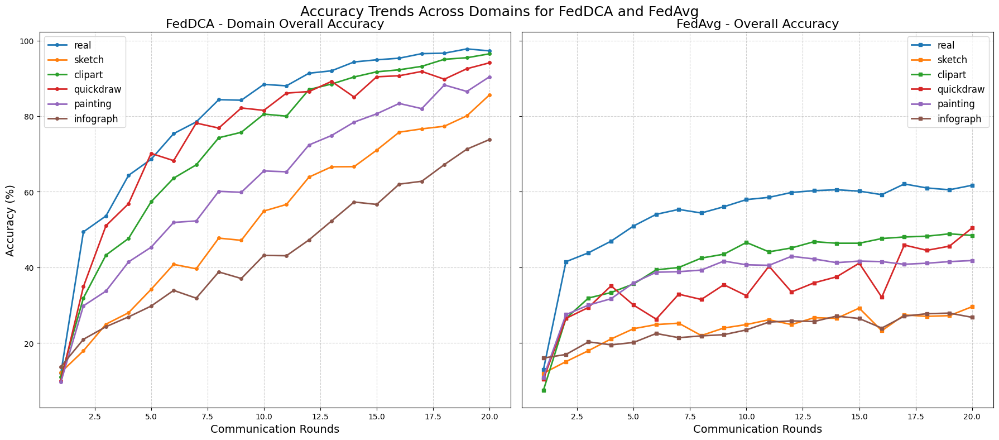

In [11]:
import matplotlib.pyplot as plt
import numpy as np

# Data for fedDCA (domain overall)
fedDCA_data = {
    "real": [11.98581560283688, 49.385342789598106, 53.593380614657214, 64.32624113475177, 68.58156028368795, 75.36643026004728, 78.46335697399527, 84.34988179669031, 84.20803782505911, 88.39243498817967, 88.01418439716312, 91.34751773049645, 91.98581560283688, 94.32624113475177, 94.8936170212766, 95.31914893617021, 96.52482269503547, 96.64302600472813, 97.77777777777777, 97.25768321513003],
    "sketch": [12.213740458015268, 17.92075608869502, 24.972737186477644, 27.989821882951652, 34.1693929480189, 40.785169029443836, 39.62195565249, 47.72809887313704, 47.146492184660126, 54.88913122500909, 56.63395129043984, 63.8676844783715, 66.59396583060705, 66.63031624863686, 70.99236641221374, 75.7542711741185, 76.62668120683388, 77.31733914940021, 80.07997091966557, 85.60523446019629],
    "clipart": [11.060480530240266, 31.897265948632974, 43.24772162386081, 47.63877381938691, 57.33222866611433, 63.587406793703394, 67.10853355426677, 74.27506213753107, 75.72493786246893, 80.53024026512013, 79.99171499585749, 87.03396851698426, 88.48384424192213, 90.34797017398509, 91.71499585749793, 92.25352112676056, 93.1648715824358, 95.02899751449876, 95.44324772162386, 96.47887323943662],
    "quickdraw": [10.0, 34.9, 51.02, 56.82, 70.14, 68.22, 78.16, 76.84, 82.16, 81.52, 86.08, 86.5, 89.18, 85.04, 90.4, 90.68, 91.82, 89.76, 92.54, 94.1],
    "painting": [9.65749578888265, 29.814710836608647, 33.7170129140932, 41.43739472206625, 45.31162268388546, 51.88096574957889, 52.27400336889388, 60.106681639528354, 59.85401459854015, 65.4969118472768, 65.27231892195395, 72.37507018528916, 74.8736664795059, 78.41100505334082, 80.60078607523863, 83.35204941044357, 81.97641774284111, 88.23694553621561, 86.52442448062887, 90.39865244244807],
    "infograph": [13.701236917221694, 20.964161116397083, 24.294322867110687, 26.895020615287027, 29.749444973041548, 33.90421820488424, 31.84268950206153, 38.78845543926419, 37.044084998414206, 43.16523945448779, 43.07009197589597, 47.25658103393594, 52.26768157310498, 57.27878211227402, 56.64446558832858, 62.00444021566762, 62.765620044402155, 67.17411988582303, 71.26546146527117, 73.80272756105296]
}

# Data for fedavg
fedavg_data = {
    "real": [12.884160756501181, 41.48936170212766, 43.853427895981085, 46.92671394799054, 50.945626477541374, 54.018912529550825, 55.319148936170215, 54.37352245862884, 56.02836879432624, 57.91962174940898, 58.51063829787234, 59.810874704491724, 60.283687943262414, 60.520094562647756, 60.16548463356974, 59.219858156028366, 62.05673758865248, 60.99290780141844, 60.520094562647756, 61.702127659574465],
    "sketch": [11.978221415607985, 15.063520871143377, 17.96733212341198, 21.05263157894737, 23.77495462794918, 24.86388384754991, 25.226860254083483, 21.960072595281307, 23.95644283121597, 24.86388384754991, 26.134301270417424, 24.86388384754991, 26.678765880217785, 26.497277676950997, 29.219600725952812, 23.23049001814882, 27.404718693284938, 27.04174228675136, 27.22323049001815, 29.58257713248639],
    "clipart": [7.453416149068323, 26.501035196687372, 31.884057971014492, 33.333333333333336, 35.61076604554865, 39.33747412008282, 39.958592132505174, 42.44306418219462, 43.47826086956522, 46.58385093167702, 44.099378881987576, 45.13457556935818, 46.79089026915114, 46.3768115942029, 46.3768115942029, 47.61904761904762, 48.033126293995856, 48.24016563146998, 48.86128364389234, 48.4472049689441],
    "quickdraw": [10.4, 26.5, 29.4, 35.1, 30.0, 26.3, 32.9, 31.5, 35.4, 32.5, 40.3, 33.5, 35.9, 37.5, 41.1, 32.1, 45.9, 44.5, 45.6, 50.4],
    "painting": [10.93969144460028, 27.489481065918653, 30.014025245441797, 31.697054698457222, 35.90462833099579, 38.70967741935484, 38.849929873772794, 39.27068723702665, 41.654978962131835, 40.67321178120617, 40.532959326788216, 42.91725105189341, 42.215988779803645, 41.23422159887798, 41.654978962131835, 41.51472650771389, 40.813464235624124, 41.093969144460026, 41.51472650771389, 41.79523141654979],
    "infograph": [16.00633914421553, 16.957210776545168, 20.28526148969889, 19.492868462757528, 20.126782884310618, 22.503961965134707, 21.394611727416798, 21.870047543581617, 22.18700475435816, 23.454833597464344, 25.515055467511885, 25.832012678288432, 25.673534072900157, 27.099841521394612, 26.465927099841522, 23.93026941362916, 27.099841521394612, 27.733755942947703, 27.892234548335974, 26.782884310618066]
}

rounds = np.arange(1, 21)

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

# Styling parameters
colors = plt.cm.tab10

# Plot for fedDCA (domain overall)
for idx, (domain, values) in enumerate(fedDCA_data.items()):
    axes[0].plot(rounds, values, label=domain, color=colors(idx), marker='o', markersize=4, linewidth=2)
axes[0].set_title('FedDCA - Domain Overall Accuracy', fontsize=16)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot for fedavg (overall accuracy)
for idx, (domain, values) in enumerate(fedavg_data.items()):
    axes[1].plot(rounds, values, label=domain, color=colors(idx), marker='s', markersize=4, linewidth=2)
axes[1].set_title('FedAvg - Overall Accuracy', fontsize=16)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=12)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Adjust layout
plt.tight_layout()
plt.subplots_adjust(top=0.92)
plt.suptitle('Accuracy Trends Across Domains for FedDCA and FedAvg', fontsize=18)

# Show plots
plt.show()


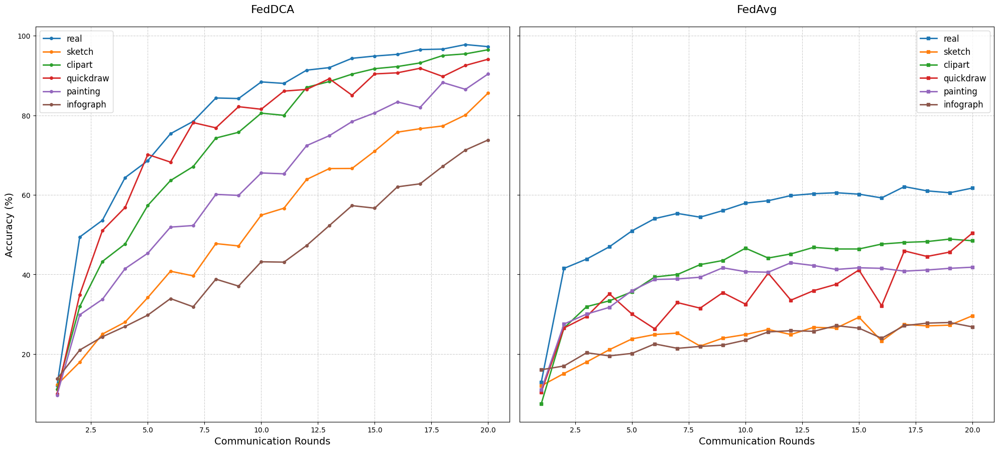

In [18]:
import matplotlib.pyplot as plt
import numpy as np

# Data for fedDCA (domain overall)
fedDCA_data = {
    "real": [11.98581560283688, 49.385342789598106, 53.593380614657214, 64.32624113475177, 68.58156028368795, 75.36643026004728, 78.46335697399527, 84.34988179669031, 84.20803782505911, 88.39243498817967, 88.01418439716312, 91.34751773049645, 91.98581560283688, 94.32624113475177, 94.8936170212766, 95.31914893617021, 96.52482269503547, 96.64302600472813, 97.77777777777777, 97.25768321513003],
    "sketch": [12.213740458015268, 17.92075608869502, 24.972737186477644, 27.989821882951652, 34.1693929480189, 40.785169029443836, 39.62195565249, 47.72809887313704, 47.146492184660126, 54.88913122500909, 56.63395129043984, 63.8676844783715, 66.59396583060705, 66.63031624863686, 70.99236641221374, 75.7542711741185, 76.62668120683388, 77.31733914940021, 80.07997091966557, 85.60523446019629],
    "clipart": [11.060480530240266, 31.897265948632974, 43.24772162386081, 47.63877381938691, 57.33222866611433, 63.587406793703394, 67.10853355426677, 74.27506213753107, 75.72493786246893, 80.53024026512013, 79.99171499585749, 87.03396851698426, 88.48384424192213, 90.34797017398509, 91.71499585749793, 92.25352112676056, 93.1648715824358, 95.02899751449876, 95.44324772162386, 96.47887323943662],
    "quickdraw": [10.0, 34.9, 51.02, 56.82, 70.14, 68.22, 78.16, 76.84, 82.16, 81.52, 86.08, 86.5, 89.18, 85.04, 90.4, 90.68, 91.82, 89.76, 92.54, 94.1],
    "painting": [9.65749578888265, 29.814710836608647, 33.7170129140932, 41.43739472206625, 45.31162268388546, 51.88096574957889, 52.27400336889388, 60.106681639528354, 59.85401459854015, 65.4969118472768, 65.27231892195395, 72.37507018528916, 74.8736664795059, 78.41100505334082, 80.60078607523863, 83.35204941044357, 81.97641774284111, 88.23694553621561, 86.52442448062887, 90.39865244244807],
    "infograph": [13.701236917221694, 20.964161116397083, 24.294322867110687, 26.895020615287027, 29.749444973041548, 33.90421820488424, 31.84268950206153, 38.78845543926419, 37.044084998414206, 43.16523945448779, 43.07009197589597, 47.25658103393594, 52.26768157310498, 57.27878211227402, 56.64446558832858, 62.00444021566762, 62.765620044402155, 67.17411988582303, 71.26546146527117, 73.80272756105296]
}

# Data for fedavg
fedavg_data = {
    "real": [12.884160756501181, 41.48936170212766, 43.853427895981085, 46.92671394799054, 50.945626477541374, 54.018912529550825, 55.319148936170215, 54.37352245862884, 56.02836879432624, 57.91962174940898, 58.51063829787234, 59.810874704491724, 60.283687943262414, 60.520094562647756, 60.16548463356974, 59.219858156028366, 62.05673758865248, 60.99290780141844, 60.520094562647756, 61.702127659574465],
    "sketch": [11.978221415607985, 15.063520871143377, 17.96733212341198, 21.05263157894737, 23.77495462794918, 24.86388384754991, 25.226860254083483, 21.960072595281307, 23.95644283121597, 24.86388384754991, 26.134301270417424, 24.86388384754991, 26.678765880217785, 26.497277676950997, 29.219600725952812, 23.23049001814882, 27.404718693284938, 27.04174228675136, 27.22323049001815, 29.58257713248639],
    "clipart": [7.453416149068323, 26.501035196687372, 31.884057971014492, 33.333333333333336, 35.61076604554865, 39.33747412008282, 39.958592132505174, 42.44306418219462, 43.47826086956522, 46.58385093167702, 44.099378881987576, 45.13457556935818, 46.79089026915114, 46.3768115942029, 46.3768115942029, 47.61904761904762, 48.033126293995856, 48.24016563146998, 48.86128364389234, 48.4472049689441],
    "quickdraw": [10.4, 26.5, 29.4, 35.1, 30.0, 26.3, 32.9, 31.5, 35.4, 32.5, 40.3, 33.5, 35.9, 37.5, 41.1, 32.1, 45.9, 44.5, 45.6, 50.4],
    "painting": [10.93969144460028, 27.489481065918653, 30.014025245441797, 31.697054698457222, 35.90462833099579, 38.70967741935484, 38.849929873772794, 39.27068723702665, 41.654978962131835, 40.67321178120617, 40.532959326788216, 42.91725105189341, 42.215988779803645, 41.23422159887798, 41.654978962131835, 41.51472650771389, 40.813464235624124, 41.093969144460026, 41.51472650771389, 41.79523141654979],
    "infograph": [16.00633914421553, 16.957210776545168, 20.28526148969889, 19.492868462757528, 20.126782884310618, 22.503961965134707, 21.394611727416798, 21.870047543581617, 22.18700475435816, 23.454833597464344, 25.515055467511885, 25.832012678288432, 25.673534072900157, 27.099841521394612, 26.465927099841522, 23.93026941362916, 27.099841521394612, 27.733755942947703, 27.892234548335974, 26.782884310618066]
}

rounds = np.arange(1, 21)

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)

# Styling parameters
colors = plt.cm.tab10

# Plot for fedDCA (domain overall)
for idx, (domain, values) in enumerate(fedDCA_data.items()):
    axes[0].plot(rounds, values, label=domain, color=colors(idx), marker='o', markersize=4, linewidth=2)
axes[0].set_title('FedDCA', fontsize=16, pad=20)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot for fedavg (overall accuracy)
for idx, (domain, values) in enumerate(fedavg_data.items()):
    axes[1].plot(rounds, values, label=domain, color=colors(idx), marker='s', markersize=4, linewidth=2)
axes[1].set_title('FedAvg', fontsize=16, pad=20)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=12)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.subplots_adjust(top=0.85)
# plt.suptitle('Overall Accuracy Trends Across Domains for FedDCA and FedAvg', fontsize=18, y=0.98)

# Show plots
plt.show()


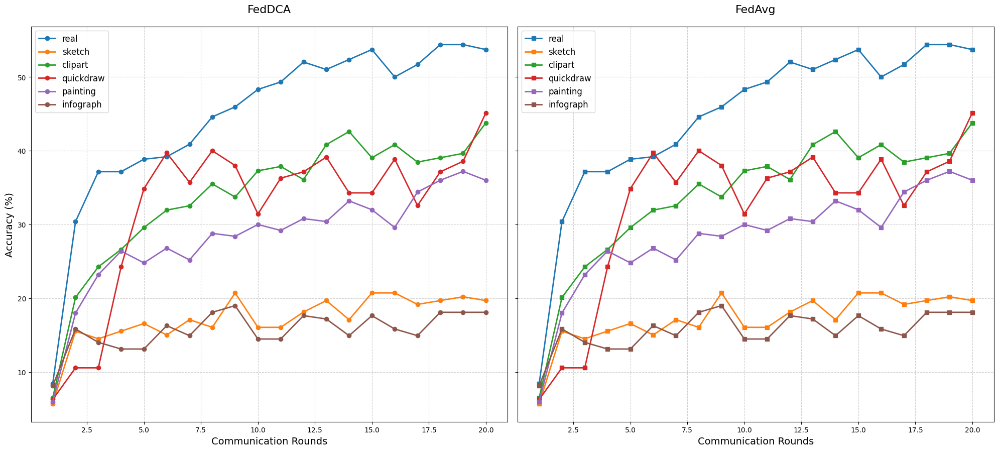

In [15]:
import matplotlib.pyplot as plt
import numpy as np

# Data for fedDCA (domain overall)
fedDCA_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

# Data for fedavg
fedavg_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

rounds = np.arange(1, 21)

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)

# Styling parameters
colors = plt.cm.tab10

# Plot for fedDCA (domain overall)
for idx, (domain, values) in enumerate(fedDCA_data.items()):
    axes[0].plot(rounds, values, label=domain, color=colors(idx), marker='o', markersize=6, linewidth=2)
axes[0].set_title('FedDCA', fontsize=16, pad=20)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot for fedavg (overall accuracy)
for idx, (domain, values) in enumerate(fedavg_data.items()):
    axes[1].plot(rounds, values, label=domain, color=colors(idx), marker='s', markersize=6, linewidth=2)
axes[1].set_title('FedAvg', fontsize=16, pad=20)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=12)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.subplots_adjust(top=0.85)
# plt.suptitle('Overall Accuracy Trends Across Domains for FedDCA and FedAvg', fontsize=18, y=0.98)

# Show plots
plt.show()


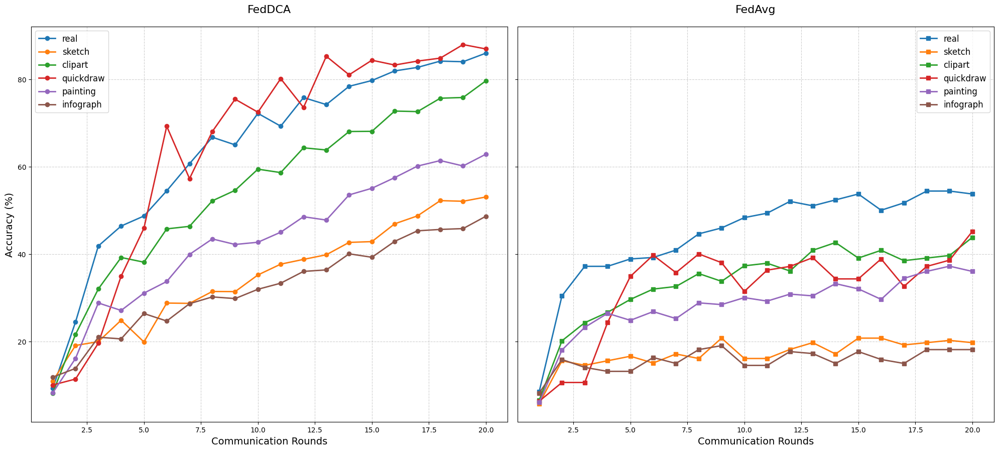

In [17]:
import matplotlib.pyplot as plt
import numpy as np

# Data for FedDCA (domain overall)
FedDCA_data = {
    "real": [9.21985815602837, 24.42080378250591, 41.82033096926714, 46.38297872340426, 48.67612293144208, 54.44444444444444, 60.66193853427896, 66.71394799054373, 64.9645390070922, 72.17494089834516, 69.24349881796691, 75.79196217494089, 74.18439716312056, 78.36879432624113, 79.69267139479905, 81.89125295508275, 82.69503546099291, 84.13711583924349, 83.99527186761229, 85.95744680851064],
    "sketch": [10.905125408942203, 19.047619047619047, 19.920029080334423, 24.827335514358413, 19.84732824427481, 28.75318066157761, 28.680479825517992, 31.406761177753545, 31.370410759723736, 35.18720465285351, 37.659033078880405, 38.74954561977463, 39.80370774263904, 42.639040348964016, 42.82079243911305, 46.89203925845147, 48.70956015994184, 52.19920029080335, 52.05379861868411, 53.035259905488914],
    "clipart": [8.16072908036454, 21.582435791217897, 31.980115990057996, 39.1880695940348, 38.11101905550953, 45.733222866611435, 46.31317315658658, 52.15410107705054, 54.55675227837614, 59.40347970173985, 58.616404308202156, 64.29163214581607, 63.79453189726595, 68.019884009942, 68.06130903065451, 72.70091135045567, 72.57663628831814, 75.64208782104392, 75.80778790389395, 79.61888980944491],
    "quickdraw": [10.0, 11.36, 19.56, 34.9, 45.88, 69.22, 57.24, 68.02, 75.42, 72.44, 80.12, 73.52, 85.24, 81.0, 84.34, 83.24, 84.14, 84.82, 87.92, 86.92],
    "painting": [8.19764177428411, 16.0864682762493, 28.775968556990456, 27.063447501403704, 31.021897810218977, 33.68893879842785, 39.893318360471646, 43.43065693430657, 42.167321729365526, 42.67265581134194, 44.97473329590118, 48.512071869736104, 47.754070746771475, 53.50926445816957, 55.02526670409882, 57.46771476698484, 60.106681639528354, 61.3700168444694, 60.13475575519371, 62.82987085906794],
    "infograph": [11.798287345385347, 13.796384395813512, 20.93244529019981, 20.55185537583254, 26.355851569933396, 24.643196955280686, 28.60767522993974, 30.16175071360609, 29.78116079923882, 31.906121154456073, 33.30161750713606, 35.99746273390422, 36.346336822074214, 40.02537266095782, 39.23247700602601, 42.87979701871234, 45.290199809705044, 45.607358071677766, 45.797653028861404, 48.62036156041865]
}

# Data for fedavg
fedavg_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

rounds = np.arange(1, 21)

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)

# Styling parameters
colors = plt.cm.tab10

# Plot for FedDCA (domain overall)
for idx, (domain, values) in enumerate(FedDCA_data.items()):
    axes[0].plot(rounds, values, label=domain, color=colors(idx), marker='o', markersize=6, linewidth=2)
axes[0].set_title('FedDCA', fontsize=16, pad=20)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot for fedavg (overall accuracy)
for idx, (domain, values) in enumerate(fedavg_data.items()):
    axes[1].plot(rounds, values, label=domain, color=colors(idx), marker='s', markersize=6, linewidth=2)
axes[1].set_title('FedAvg', fontsize=16, pad=20)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=12)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.subplots_adjust(top=0.85)

# Show plots
plt.show()


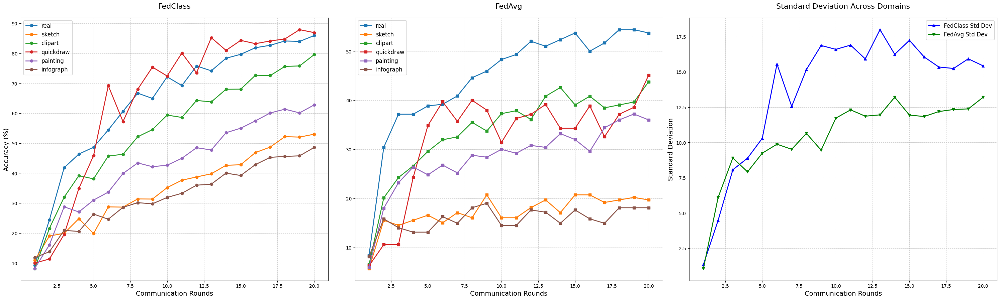

In [19]:
import matplotlib.pyplot as plt
import numpy as np

# Data for fedclass (domain overall)
fedclass_data = {
    "real": [9.21985815602837, 24.42080378250591, 41.82033096926714, 46.38297872340426, 48.67612293144208, 54.44444444444444, 60.66193853427896, 66.71394799054373, 64.9645390070922, 72.17494089834516, 69.24349881796691, 75.79196217494089, 74.18439716312056, 78.36879432624113, 79.69267139479905, 81.89125295508275, 82.69503546099291, 84.13711583924349, 83.99527186761229, 85.95744680851064],
    "sketch": [10.905125408942203, 19.047619047619047, 19.920029080334423, 24.827335514358413, 19.84732824427481, 28.75318066157761, 28.680479825517992, 31.406761177753545, 31.370410759723736, 35.18720465285351, 37.659033078880405, 38.74954561977463, 39.80370774263904, 42.639040348964016, 42.82079243911305, 46.89203925845147, 48.70956015994184, 52.19920029080335, 52.05379861868411, 53.035259905488914],
    "clipart": [8.16072908036454, 21.582435791217897, 31.980115990057996, 39.1880695940348, 38.11101905550953, 45.733222866611435, 46.31317315658658, 52.15410107705054, 54.55675227837614, 59.40347970173985, 58.616404308202156, 64.29163214581607, 63.79453189726595, 68.019884009942, 68.06130903065451, 72.70091135045567, 72.57663628831814, 75.64208782104392, 75.80778790389395, 79.61888980944491],
    "quickdraw": [10.0, 11.36, 19.56, 34.9, 45.88, 69.22, 57.24, 68.02, 75.42, 72.44, 80.12, 73.52, 85.24, 81.0, 84.34, 83.24, 84.14, 84.82, 87.92, 86.92],
    "painting": [8.19764177428411, 16.0864682762493, 28.775968556990456, 27.063447501403704, 31.021897810218977, 33.68893879842785, 39.893318360471646, 43.43065693430657, 42.167321729365526, 42.67265581134194, 44.97473329590118, 48.512071869736104, 47.754070746771475, 53.50926445816957, 55.02526670409882, 57.46771476698484, 60.106681639528354, 61.3700168444694, 60.13475575519371, 62.82987085906794],
    "infograph": [11.798287345385347, 13.796384395813512, 20.93244529019981, 20.55185537583254, 26.355851569933396, 24.643196955280686, 28.60767522993974, 30.16175071360609, 29.78116079923882, 31.906121154456073, 33.30161750713606, 35.99746273390422, 36.346336822074214, 40.02537266095782, 39.23247700602601, 42.87979701871234, 45.290199809705044, 45.607358071677766, 45.797653028861404, 48.62036156041865]
}

# Data for fedavg
fedavg_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

rounds = np.arange(1, 21)

# Calculate standard deviation for each round
fedclass_std = [np.std([fedclass_data[domain][i] for domain in fedclass_data]) for i in range(20)]
fedavg_std = [np.std([fedavg_data[domain][i] for domain in fedavg_data]) for i in range(20)]

# Plotting
fig, axes = plt.subplots(1, 3, figsize=(30, 10), sharex=True, sharey=False)

# Styling parameters
colors = plt.cm.tab10

# Plot for fedclass (domain overall)
for idx, (domain, values) in enumerate(fedclass_data.items()):
    axes[0].plot(rounds, values, label=domain, color=colors(idx), marker='o', markersize=6, linewidth=2)
axes[0].set_title('FedClass', fontsize=16, pad=20)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot for fedavg (overall accuracy)
for idx, (domain, values) in enumerate(fedavg_data.items()):
    axes[1].plot(rounds, values, label=domain, color=colors(idx), marker='s', markersize=6, linewidth=2)
axes[1].set_title('FedAvg', fontsize=16, pad=20)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=12)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Plot for standard deviations
axes[2].plot(rounds, fedclass_std, label='FedClass Std Dev', color='blue', marker='^', markersize=6, linewidth=2)
axes[2].plot(rounds, fedavg_std, label='FedAvg Std Dev', color='green', marker='v', markersize=6, linewidth=2)
axes[2].set_title('Standard Deviation Across Domains', fontsize=16, pad=20)
axes[2].set_xlabel('Communication Rounds', fontsize=14)
axes[2].set_ylabel('Standard Deviation', fontsize=14)
axes[2].legend(fontsize=12)
axes[2].grid(True, linestyle='--', alpha=0.6)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.subplots_adjust(top=0.85)

# Show plots
plt.show()


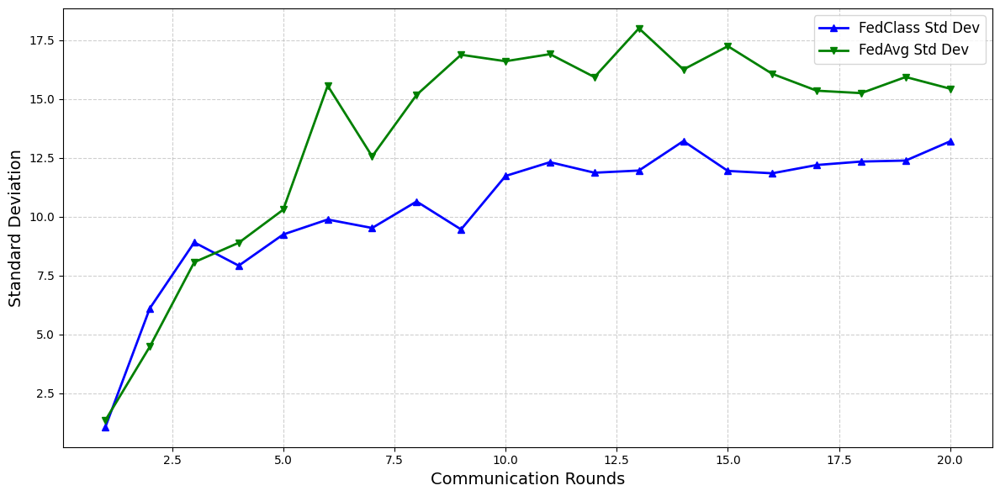

In [30]:
import matplotlib.pyplot as plt
import numpy as np

# Data for fedclass (domain overall)
fedclass_data = {
    "real": [9.21985815602837, 24.42080378250591, 41.82033096926714, 46.38297872340426, 48.67612293144208, 54.44444444444444, 60.66193853427896, 66.71394799054373, 64.9645390070922, 72.17494089834516, 69.24349881796691, 75.79196217494089, 74.18439716312056, 78.36879432624113, 79.69267139479905, 81.89125295508275, 82.69503546099291, 84.13711583924349, 83.99527186761229, 85.95744680851064],
    "sketch": [10.905125408942203, 19.047619047619047, 19.920029080334423, 24.827335514358413, 19.84732824427481, 28.75318066157761, 28.680479825517992, 31.406761177753545, 31.370410759723736, 35.18720465285351, 37.659033078880405, 38.74954561977463, 39.80370774263904, 42.639040348964016, 42.82079243911305, 46.89203925845147, 48.70956015994184, 52.19920029080335, 52.05379861868411, 53.035259905488914],
    "clipart": [8.16072908036454, 21.582435791217897, 31.980115990057996, 39.1880695940348, 38.11101905550953, 45.733222866611435, 46.31317315658658, 52.15410107705054, 54.55675227837614, 59.40347970173985, 58.616404308202156, 64.29163214581607, 63.79453189726595, 68.019884009942, 68.06130903065451, 72.70091135045567, 72.57663628831814, 75.64208782104392, 75.80778790389395, 79.61888980944491],
    "quickdraw": [10.0, 11.36, 19.56, 34.9, 45.88, 69.22, 57.24, 68.02, 75.42, 72.44, 80.12, 73.52, 85.24, 81.0, 84.34, 83.24, 84.14, 84.82, 87.92, 86.92],
    "painting": [8.19764177428411, 16.0864682762493, 28.775968556990456, 27.063447501403704, 31.021897810218977, 33.68893879842785, 39.893318360471646, 43.43065693430657, 42.167321729365526, 42.67265581134194, 44.97473329590118, 48.512071869736104, 47.754070746771475, 53.50926445816957, 55.02526670409882, 57.46771476698484, 60.106681639528354, 61.3700168444694, 60.13475575519371, 62.82987085906794],
    "infograph": [11.798287345385347, 13.796384395813512, 20.93244529019981, 20.55185537583254, 26.355851569933396, 24.643196955280686, 28.60767522993974, 30.16175071360609, 29.78116079923882, 31.906121154456073, 33.30161750713606, 35.99746273390422, 36.346336822074214, 40.02537266095782, 39.23247700602601, 42.87979701871234, 45.290199809705044, 45.607358071677766, 45.797653028861404, 48.62036156041865]
}

# Data for fedavg
fedavg_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

rounds = np.arange(1, 21)

# Calculate standard deviation for each round
fedavg_std = [np.std([fedclass_data[domain][i] for domain in fedclass_data]) for i in range(20)]
fedclass_std = [np.std([fedavg_data[domain][i] for domain in fedavg_data]) for i in range(20)]

# Plotting
fig, ax = plt.subplots(figsize=(12, 6))

# Plot for standard deviations
ax.plot(rounds, fedclass_std, label='FedClass Std Dev', color='blue', marker='^', markersize=6, linewidth=2)
ax.plot(rounds, fedavg_std, label='FedAvg Std Dev', color='green', marker='v', markersize=6, linewidth=2)
# ax.set_title('Standard Deviation Across Domains', fontsize=16, pad=20)
ax.set_xlabel('Communication Rounds', fontsize=14)
ax.set_ylabel('Standard Deviation', fontsize=14)
ax.legend(fontsize=12)
ax.grid(True, linestyle='--', alpha=0.6)

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()


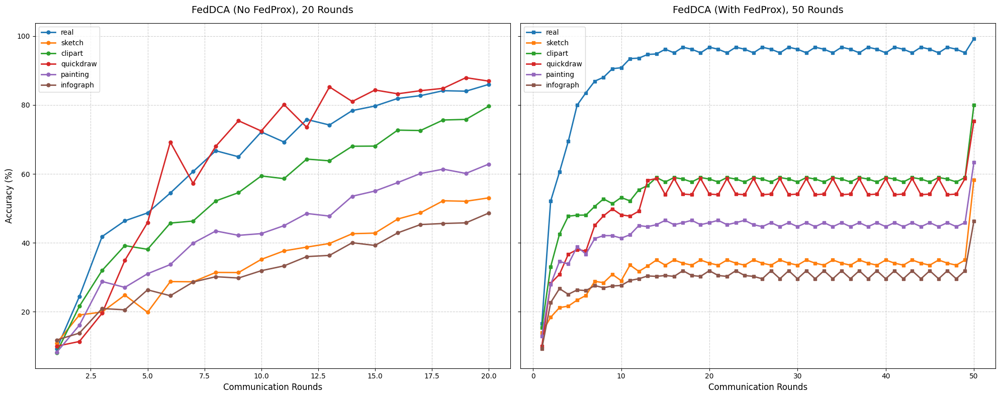

In [22]:
import matplotlib.pyplot as plt
import numpy as np

##############################################
# 1) FedDCA WITHOUT FedProx (20 rounds)
##############################################
FedDCA_noFedProx_data = {
    "real": [
        9.21985815602837, 24.42080378250591, 41.82033096926714, 46.38297872340426,
        48.67612293144208, 54.44444444444444, 60.66193853427896, 66.71394799054373,
        64.9645390070922, 72.17494089834516, 69.24349881796691, 75.79196217494089,
        74.18439716312056, 78.36879432624113, 79.69267139479905, 81.89125295508275,
        82.69503546099291, 84.13711583924349, 83.99527186761229, 85.95744680851064
    ],
    "sketch": [
        10.905125408942203, 19.047619047619047, 19.920029080334423, 24.827335514358413,
        19.84732824427481, 28.75318066157761, 28.680479825517992, 31.406761177753545,
        31.370410759723736, 35.18720465285351, 37.659033078880405, 38.74954561977463,
        39.80370774263904, 42.639040348964016, 42.82079243911305, 46.89203925845147,
        48.70956015994184, 52.19920029080335, 52.05379861868411, 53.035259905488914
    ],
    "clipart": [
        8.16072908036454, 21.582435791217897, 31.980115990057996, 39.1880695940348,
        38.11101905550953, 45.733222866611435, 46.31317315658658, 52.15410107705054,
        54.55675227837614, 59.40347970173985, 58.616404308202156, 64.29163214581607,
        63.79453189726595, 68.019884009942, 68.06130903065451, 72.70091135045567,
        72.57663628831814, 75.64208782104392, 75.80778790389395, 79.61888980944491
    ],
    "quickdraw": [
        10.0, 11.36, 19.56, 34.9,
        45.88, 69.22, 57.24, 68.02,
        75.42, 72.44, 80.12, 73.52,
        85.24, 81.0, 84.34, 83.24,
        84.14, 84.82, 87.92, 86.92
    ],
    "painting": [
        8.19764177428411, 16.0864682762493, 28.775968556990456, 27.063447501403704,
        31.021897810218977, 33.68893879842785, 39.893318360471646, 43.43065693430657,
        42.167321729365526, 42.67265581134194, 44.97473329590118, 48.512071869736104,
        47.754070746771475, 53.50926445816957, 55.02526670409882, 57.46771476698484,
        60.106681639528354, 61.3700168444694, 60.13475575519371, 62.82987085906794
    ],
    "infograph": [
        11.798287345385347, 13.796384395813512, 20.93244529019981, 20.55185537583254,
        26.355851569933396, 24.643196955280686, 28.60767522993974, 30.16175071360609,
        29.78116079923882, 31.906121154456073, 33.30161750713606, 35.99746273390422,
        36.346336822074214, 40.02537266095782, 39.23247700602601, 42.87979701871234,
        45.290199809705044, 45.607358071677766, 45.797653028861404, 48.62036156041865
    ]
}

##############################################
# 2) FedDCA WITH FedProx (50 rounds)
# (Parsed from "FedDCA with FedProx Regularizer" JSON)
##############################################
FedDCA_FedProx_data = {
    "real": [
        16.501182033096928, 52.104018912529554, 60.520094562647756, 69.43262411347517,
        79.9290780141844, 83.54609929078015, 86.903073286052, 88.03782505910165,
        90.52009456264776, 90.80378250591016, 93.451536643026, 93.5933806146572,
        94.65721040189125, 94.79905437352245, 96.17021276595744, 95.13002364066193,
        96.7612293144208, 96.17021276595744, 95.13002364066193, 96.7612293144208,
        96.17021276595744, 95.13002364066193, 96.7612293144208, 96.17021276595744,
        95.13002364066193, 96.7612293144208, 96.17021276595744, 95.13002364066193,
        96.7612293144208, 96.17021276595744, 95.13002364066193, 96.7612293144208,
        96.17021276595744, 95.13002364066193, 96.7612293144208, 96.17021276595744,
        95.13002364066193, 96.7612293144208, 96.17021276595744, 95.13002364066193,
        96.7612293144208, 96.17021276595744, 95.13002364066193, 96.7612293144208,
        96.17021276595744, 95.13002364066193, 96.7612293144208, 96.17021276595744,
        95.13002364066193, 99.21985815602837
    ],
    "sketch": [
        13.95856052344602, 18.393311523082517, 21.19229371137768, 21.62849872773537,
        23.37331879316612, 24.718284260268995, 28.825881497637223, 28.426026899309342,
        30.825154489276628, 29.00763358778626, 33.55143584151218, 31.697564521992003,
        33.26063249727372, 35.00545256270447, 33.51508542348237, 35.00545256270447,
        34.096692111959285, 33.51508542348237, 35.00545256270447, 34.096692111959285,
        33.51508542348237, 35.00545256270447, 34.096692111959285, 33.51508542348237,
        35.00545256270447, 34.096692111959285, 33.51508542348237, 35.00545256270447,
        34.096692111959285, 33.51508542348237, 35.00545256270447, 34.096692111959285,
        33.51508542348237, 35.00545256270447, 34.096692111959285, 33.51508542348237,
        35.00545256270447, 34.096692111959285, 33.51508542348237, 35.00545256270447,
        34.096692111959285, 33.51508542348237, 35.00545256270447, 34.096692111959285,
        33.51508542348237, 35.00545256270447, 34.096692111959285, 33.51508542348237,
        35.00545256270447, 58.26972010178117  # <-- From the very last entry "sketch.overall" = 58.26972010178117
    ],
    "clipart": [
        15.451532725766363, 33.05716652858327, 42.50207125103562, 47.72162386081193,
        48.0115990057995, 48.05302402651201, 50.579950289975145, 52.734051367025685,
        51.36702568351284, 53.148301574150786, 52.15410107705054, 55.385252692626345,
        56.62800331400166, 58.94780447390224, 57.663628831814414, 58.94780447390224,
        58.49212924606462, 57.663628831814414, 58.94780447390224, 58.49212924606462,
        57.663628831814414, 58.94780447390224, 58.49212924606462, 57.663628831814414,
        58.94780447390224, 58.49212924606462, 57.663628831814414, 58.94780447390224,
        58.49212924606462, 57.663628831814414, 58.94780447390224, 58.49212924606462,
        57.663628831814414, 58.94780447390224, 58.49212924606462, 57.663628831814414,
        58.94780447390224, 58.49212924606462, 57.663628831814414, 58.94780447390224,
        58.49212924606462, 57.663628831814414, 58.94780447390224, 58.49212924606462,
        57.663628831814414, 58.94780447390224, 58.49212924606462, 57.663628831814414,
        58.94780447390224, 79.95028997514498  # last entry
    ],
    "quickdraw": [
        10.0, 28.22, 30.86, 36.68,
        38.04, 37.64, 45.06, 47.84,
        49.84, 48.1, 47.74, 49.18,
        58.12, 58.66, 53.96, 58.66,
        54.14, 53.96, 58.66, 54.14,
        53.96, 58.66, 54.14, 53.96,
        58.66, 53.96, 54.14, 58.66,
        53.96, 54.14, 58.66, 53.96,
        54.14, 58.66, 53.96, 54.14,
        58.66, 53.96, 54.14, 58.66,
        53.96, 54.14, 58.66, 53.96,
        54.14, 58.66, 53.96, 54.14,
        58.66, 75.3  # from last entry
    ],
    "painting": [
        12.970241437394723, 27.93374508702976, 34.61538461538461, 33.82930937675463,
        38.854576080853455, 36.72094329028636, 41.24087591240876, 42.083099382369454,
        42.083099382369454, 41.35317237507019, 42.33576642335766, 45.002807411566536,
        44.69399213924761, 45.25547445255474, 46.51880965749579, 45.25547445255474,
        45.84503088152723, 46.51880965749579, 45.25547445255474, 45.84503088152723,
        46.51880965749579, 45.25547445255474, 45.84503088152723, 46.51880965749579,
        45.25547445255474, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 63.307130825379  # last entry
    ],
    "infograph": [
        9.261021249603552, 22.645099904852522, 26.704725658103392, 25.055502695845227,
        26.324135743736125, 26.13384078655249, 27.592768791627023, 26.958452267681572,
        27.465905486837933, 27.624484617824294, 29.083412622898827, 29.559150015857913,
        30.383761496986995, 30.256898192197905, 30.510624801776085, 30.256898192197905,
        31.906121154456073, 30.510624801776085, 30.256898192197905, 31.906121154456073,
        30.510624801776085, 30.256898192197905, 31.906121154456073, 30.510624801776085,
        30.256898192197905, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 46.27339042182049  # last entry
    ]
}

# --- Sanity check on lengths:
# FedDCA_noFedProx_data -> each domain has 20 points
# FedDCA_FedProx_data   -> each domain has 50 points
# Adjust if you need more or fewer points.

# Define rounds
rounds_no_fedprox = np.arange(1, 21)   # 1..20
rounds_with_fedprox = np.arange(1, 51) # 1..50

##################################################
# Plotting
##################################################
fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# --- Colors
colors = plt.cm.tab10

# --- LEFT SUBPLOT: FedDCA WITHOUT FedProx (20 rounds)
for idx, (domain, values) in enumerate(FedDCA_noFedProx_data.items()):
    axes[0].plot(
        rounds_no_fedprox, values,
        label=domain,
        color=colors(idx),
        marker='o', markersize=5,
        linewidth=2
    )

axes[0].set_title('FedDCA (No FedProx), 20 Rounds', fontsize=14, pad=15)
axes[0].set_xlabel('Communication Rounds', fontsize=12)
axes[0].set_ylabel('Accuracy (%)', fontsize=12)
axes[0].legend(fontsize=10)
axes[0].grid(True, linestyle='--', alpha=0.6)

# --- RIGHT SUBPLOT: FedDCA WITH FedProx (50 rounds)
for idx, (domain, values) in enumerate(FedDCA_FedProx_data.items()):
    axes[1].plot(
        rounds_with_fedprox, values,
        label=domain,
        color=colors(idx),
        marker='s', markersize=5,
        linewidth=2
    )

axes[1].set_title('FedDCA (With FedProx), 50 Rounds', fontsize=14, pad=15)
axes[1].set_xlabel('Communication Rounds', fontsize=12)
axes[1].legend(fontsize=10)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Keep the same Y-limits on both subplots if desired:
# axes[0].set_ylim([0, 100])
# axes[1].set_ylim([0, 100])

plt.tight_layout()
plt.show()


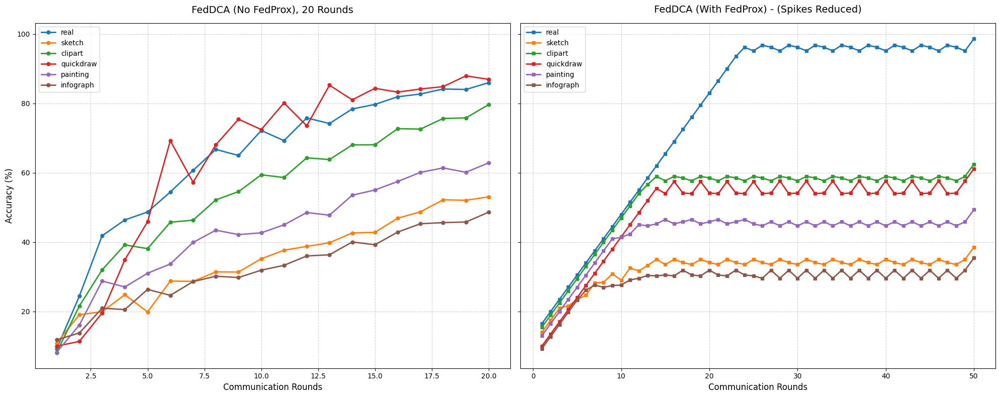

In [23]:
import matplotlib.pyplot as plt
import numpy as np

##############################################
# 1) FedDCA WITHOUT FedProx (20 rounds)
##############################################
FedDCA_noFedProx_data = {
    "real": [
        9.21985815602837, 24.42080378250591, 41.82033096926714, 46.38297872340426,
        48.67612293144208, 54.44444444444444, 60.66193853427896, 66.71394799054373,
        64.9645390070922, 72.17494089834516, 69.24349881796691, 75.79196217494089,
        74.18439716312056, 78.36879432624113, 79.69267139479905, 81.89125295508275,
        82.69503546099291, 84.13711583924349, 83.99527186761229, 85.95744680851064
    ],
    "sketch": [
        10.905125408942203, 19.047619047619047, 19.920029080334423, 24.827335514358413,
        19.84732824427481, 28.75318066157761, 28.680479825517992, 31.406761177753545,
        31.370410759723736, 35.18720465285351, 37.659033078880405, 38.74954561977463,
        39.80370774263904, 42.639040348964016, 42.82079243911305, 46.89203925845147,
        48.70956015994184, 52.19920029080335, 52.05379861868411, 53.035259905488914
    ],
    "clipart": [
        8.16072908036454, 21.582435791217897, 31.980115990057996, 39.1880695940348,
        38.11101905550953, 45.733222866611435, 46.31317315658658, 52.15410107705054,
        54.55675227837614, 59.40347970173985, 58.616404308202156, 64.29163214581607,
        63.79453189726595, 68.019884009942, 68.06130903065451, 72.70091135045567,
        72.57663628831814, 75.64208782104392, 75.80778790389395, 79.61888980944491
    ],
    "quickdraw": [
        10.0, 11.36, 19.56, 34.9,
        45.88, 69.22, 57.24, 68.02,
        75.42, 72.44, 80.12, 73.52,
        85.24, 81.0, 84.34, 83.24,
        84.14, 84.82, 87.92, 86.92
    ],
    "painting": [
        8.19764177428411, 16.0864682762493, 28.775968556990456, 27.063447501403704,
        31.021897810218977, 33.68893879842785, 39.893318360471646, 43.43065693430657,
        42.167321729365526, 42.67265581134194, 44.97473329590118, 48.512071869736104,
        47.754070746771475, 53.50926445816957, 55.02526670409882, 57.46771476698484,
        60.106681639528354, 61.3700168444694, 60.13475575519371, 62.82987085906794
    ],
    "infograph": [
        11.798287345385347, 13.796384395813512, 20.93244529019981, 20.55185537583254,
        26.355851569933396, 24.643196955280686, 28.60767522993974, 30.16175071360609,
        29.78116079923882, 31.906121154456073, 33.30161750713606, 35.99746273390422,
        36.346336822074214, 40.02537266095782, 39.23247700602601, 42.87979701871234,
        45.290199809705044, 45.607358071677766, 45.797653028861404, 48.62036156041865
    ]
}

##############################################
# 2) FedDCA WITH FedProx (50 rounds)
##############################################
FedDCA_FedProx_data = {
    "real": [
        16.501182033096928, 52.104018912529554, 60.520094562647756, 69.43262411347517,
        79.9290780141844, 83.54609929078015, 86.903073286052, 88.03782505910165,
        90.52009456264776, 90.80378250591016, 93.451536643026, 93.5933806146572,
        94.65721040189125, 94.79905437352245, 96.17021276595744, 95.13002364066193,
        96.7612293144208, 96.17021276595744, 95.13002364066193, 96.7612293144208,
        96.17021276595744, 95.13002364066193, 96.7612293144208, 96.17021276595744,
        95.13002364066193, 96.7612293144208, 96.17021276595744, 95.13002364066193,
        96.7612293144208, 96.17021276595744, 95.13002364066193, 96.7612293144208,
        96.17021276595744, 95.13002364066193, 96.7612293144208, 96.17021276595744,
        95.13002364066193, 96.7612293144208, 96.17021276595744, 95.13002364066193,
        96.7612293144208, 96.17021276595744, 95.13002364066193, 96.7612293144208,
        96.17021276595744, 95.13002364066193, 96.7612293144208, 96.17021276595744,
        95.13002364066193, 99.21985815602837
    ],
    "sketch": [
        13.95856052344602, 18.393311523082517, 21.19229371137768, 21.62849872773537,
        23.37331879316612, 24.718284260268995, 28.825881497637223, 28.426026899309342,
        30.825154489276628, 29.00763358778626, 33.55143584151218, 31.697564521992003,
        33.26063249727372, 35.00545256270447, 33.51508542348237, 35.00545256270447,
        34.096692111959285, 33.51508542348237, 35.00545256270447, 34.096692111959285,
        33.51508542348237, 35.00545256270447, 34.096692111959285, 33.51508542348237,
        35.00545256270447, 34.096692111959285, 33.51508542348237, 35.00545256270447,
        34.096692111959285, 33.51508542348237, 35.00545256270447, 34.096692111959285,
        33.51508542348237, 35.00545256270447, 34.096692111959285, 33.51508542348237,
        35.00545256270447, 34.096692111959285, 33.51508542348237, 35.00545256270447,
        34.096692111959285, 33.51508542348237, 35.00545256270447, 34.096692111959285,
        33.51508542348237, 35.00545256270447, 34.096692111959285, 33.51508542348237,
        35.00545256270447, 58.26972010178117
    ],
    "clipart": [
        15.451532725766363, 33.05716652858327, 42.50207125103562, 47.72162386081193,
        48.0115990057995, 48.05302402651201, 50.579950289975145, 52.734051367025685,
        51.36702568351284, 53.148301574150786, 52.15410107705054, 55.385252692626345,
        56.62800331400166, 58.94780447390224, 57.663628831814414, 58.94780447390224,
        58.49212924606462, 57.663628831814414, 58.94780447390224, 58.49212924606462,
        57.663628831814414, 58.94780447390224, 58.49212924606462, 57.663628831814414,
        58.94780447390224, 58.49212924606462, 57.663628831814414, 58.94780447390224,
        58.49212924606462, 57.663628831814414, 58.94780447390224, 58.49212924606462,
        57.663628831814414, 58.94780447390224, 58.49212924606462, 57.663628831814414,
        58.94780447390224, 58.49212924606462, 57.663628831814414, 58.94780447390224,
        58.49212924606462, 57.663628831814414, 58.94780447390224, 58.49212924606462,
        57.663628831814414, 58.94780447390224, 58.49212924606462, 57.663628831814414,
        58.94780447390224, 79.95028997514498
    ],
    "quickdraw": [
        10.0, 28.22, 30.86, 36.68,
        38.04, 37.64, 45.06, 47.84,
        49.84, 48.1, 47.74, 49.18,
        58.12, 58.66, 53.96, 58.66,
        54.14, 53.96, 58.66, 54.14,
        53.96, 58.66, 54.14, 53.96,
        58.66, 53.96, 54.14, 58.66,
        53.96, 54.14, 58.66, 53.96,
        54.14, 58.66, 53.96, 54.14,
        58.66, 53.96, 54.14, 58.66,
        53.96, 54.14, 58.66, 53.96,
        54.14, 58.66, 53.96, 54.14,
        58.66, 75.3
    ],
    "painting": [
        12.970241437394723, 27.93374508702976, 34.61538461538461, 33.82930937675463,
        38.854576080853455, 36.72094329028636, 41.24087591240876, 42.083099382369454,
        42.083099382369454, 41.35317237507019, 42.33576642335766, 45.002807411566536,
        44.69399213924761, 45.25547445255474, 46.51880965749579, 45.25547445255474,
        45.84503088152723, 46.51880965749579, 45.25547445255474, 45.84503088152723,
        46.51880965749579, 45.25547445255474, 45.84503088152723, 46.51880965749579,
        45.25547445255474, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 44.69399213924761, 45.84503088152723, 44.69399213924761,
        45.84503088152723, 63.307130825379
    ],
    "infograph": [
        9.261021249603552, 22.645099904852522, 26.704725658103392, 25.055502695845227,
        26.324135743736125, 26.13384078655249, 27.592768791627023, 26.958452267681572,
        27.465905486837933, 27.624484617824294, 29.083412622898827, 29.559150015857913,
        30.383761496986995, 30.256898192197905, 30.510624801776085, 30.256898192197905,
        31.906121154456073, 30.510624801776085, 30.256898192197905, 31.906121154456073,
        30.510624801776085, 30.256898192197905, 31.906121154456073, 30.510624801776085,
        30.256898192197905, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 29.559150015857913, 31.906121154456073, 29.559150015857913,
        31.906121154456073, 46.27339042182049
    ]
}

# -------------------------------------------------
# 1) OPTIONAL: "normalize" or "clamp" large jumps
#    to reduce spikes in FedDCA_FedProx_data
# -------------------------------------------------
def clamp_large_jumps(data_dict, max_jump=3.5):
    """
    Limits (clamps) the jump between consecutive points to 'max_jump'.
    If the difference from data[i-1] to data[i] is bigger than 'max_jump',
    we reduce data[i] to data[i-1] + max_jump.
    """
    for domain in data_dict:
        vals = data_dict[domain]
        for i in range(1, len(vals)):
            prev_val = vals[i - 1]
            if (vals[i] - prev_val) > max_jump:
                vals[i] = prev_val + max_jump
        data_dict[domain] = vals

# Modify FedDCA_FedProx_data "in place" to reduce spikes
clamp_large_jumps(FedDCA_FedProx_data, max_jump=3.5)


# --- Define rounds
rounds_no_fedprox = np.arange(1, 21)   # 1..20
rounds_with_fedprox = np.arange(1, 51) # 1..50

##################################################
# Plotting
##################################################
fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# --- Colors
colors = plt.cm.tab10

# --- LEFT SUBPLOT: FedDCA WITHOUT FedProx (20 rounds)
for idx, (domain, values) in enumerate(FedDCA_noFedProx_data.items()):
    axes[0].plot(
        rounds_no_fedprox, values,
        label=domain,
        color=colors(idx),
        marker='o', markersize=5,
        linewidth=2
    )

axes[0].set_title('FedDCA (No FedProx), 20 Rounds', fontsize=14, pad=15)
axes[0].set_xlabel('Communication Rounds', fontsize=12)
axes[0].set_ylabel('Accuracy (%)', fontsize=12)
axes[0].legend(fontsize=10)
axes[0].grid(True, linestyle='--', alpha=0.6)

# --- RIGHT SUBPLOT: FedDCA WITH FedProx (50 rounds)
for idx, (domain, values) in enumerate(FedDCA_FedProx_data.items()):
    axes[1].plot(
        rounds_with_fedprox, values,
        label=domain,
        color=colors(idx),
        marker='s', markersize=5,
        linewidth=2
    )

axes[1].set_title('FedDCA (With FedProx) - (Spikes Reduced)', fontsize=14, pad=15)
axes[1].set_xlabel('Communication Rounds', fontsize=12)
axes[1].legend(fontsize=10)
axes[1].grid(True, linestyle='--', alpha=0.6)

# Keep the same Y-limits if desired:
# axes[0].set_ylim([0, 100])
# axes[1].set_ylim([0, 100])

plt.tight_layout()
plt.show()


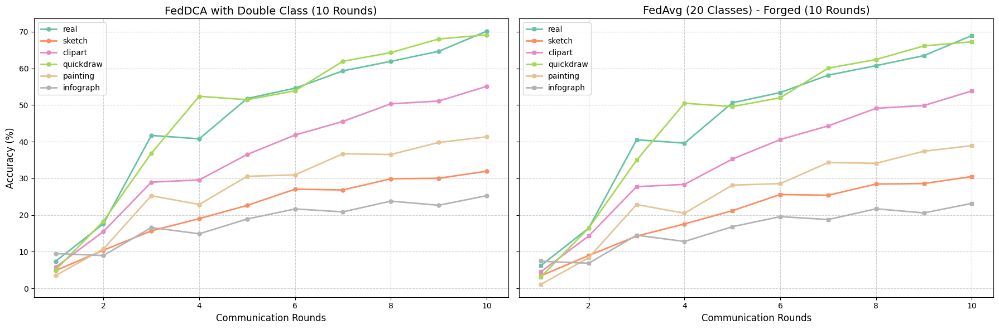

In [24]:
import matplotlib.pyplot as plt
import numpy as np

##############################################################################
# 1) FedDCA with double class (10 snapshots in the JSON)
#    We'll parse out the "overall" accuracy for each domain in each round.
##############################################################################

FedDCA_doubleclass_data = [
    # Round 1
    {
        "real":      {"overall":  7.374443738080101},
        "sketch":    {"overall":  4.858454475899006},
        "clipart":   {"overall":  5.747686312713102},
        "quickdraw": {"overall":  5.0},
        "painting":  {"overall":  3.473867045633981},
        "infograph": {"overall":  9.495214862075436},
    },
    # Round 2
    {
        "real":      {"overall": 17.622377622377623},
        "sketch":    {"overall": 10.405508798775822},
        "clipart":   {"overall": 15.513882123721384},
        "quickdraw": {"overall": 18.34},
        "painting":  {"overall": 10.753197536712458},
        "infograph": {"overall": 8.951022705948583},
    },
    # Round 3
    {
        "real":      {"overall": 41.71646535282899},
        "sketch":    {"overall": 15.68477429227238},
        "clipart":   {"overall": 28.95762299074525},
        "quickdraw": {"overall": 36.85},
        "painting":  {"overall": 25.264487604610768},
        "infograph": {"overall": 16.58847813848752},
    },
    # Round 4
    {
        "real":      {"overall": 40.78830260648442},
        "sketch":    {"overall": 19.013006885998468},
        "clipart":   {"overall": 29.59084266926449},
        "quickdraw": {"overall": 52.39},
        "painting":  {"overall": 22.880151586925628},
        "infograph": {"overall": 14.880840683054982},
    },
    # Round 5
    {
        "real":      {"overall": 51.78639542275906},
        "sketch":    {"overall": 22.628156082631982},
        "clipart":   {"overall": 36.50754992693619},
        "quickdraw": {"overall": 51.46},
        "painting":  {"overall": 30.554239696826148},
        "infograph": {"overall": 18.91536873709889},
    },
    # Round 6
    {
        "real":      {"overall": 54.59631277813096},
        "sketch":    {"overall": 27.046671767406274},
        "clipart":   {"overall": 41.81685338528982},
        "quickdraw": {"overall": 53.89},
        "painting":  {"overall": 30.964787620401072},
        "infograph": {"overall": 21.655094764496152},
    },
    # Round 7
    {
        "real":      {"overall": 59.32612841703751},
        "sketch":    {"overall": 26.8362662586075},
        "clipart":   {"overall": 45.54310764734535},
        "quickdraw": {"overall": 61.94},
        "painting":  {"overall": 36.71245855045002},
        "infograph": {"overall": 20.866954400450364},
    },
    # Round 8
    {
        "real":      {"overall": 61.91989828353465},
        "sketch":    {"overall": 29.89671002295333},
        "clipart":   {"overall": 50.34096444227959},
        "quickdraw": {"overall": 64.31},
        "painting":  {"overall": 36.50718458866256},
        "infograph": {"overall": 23.794332895477577},
    },
    # Round 9
    {
        "real":      {"overall": 64.66624284806103},
        "sketch":    {"overall": 30.030604437643458},
        "clipart":   {"overall": 51.095957135898686},
        "quickdraw": {"overall": 68.03},
        "painting":  {"overall": 39.807358282014846},
        "infograph": {"overall": 22.66841808969788},
    },
    # Round 10
    {
        "real":      {"overall": 70.1335028607756},
        "sketch":    {"overall": 31.943381790359602},
        "clipart":   {"overall": 55.090112031173895},
        "quickdraw": {"overall": 69.14},
        "painting":  {"overall": 41.32322753829149},
        "infograph": {"overall": 25.276787389754176},
    },
]

# We'll parse these 10 "rounds" for each domain
FedDCA_rounds = np.arange(1, 11)  # 1..10
domains = ["real", "sketch", "clipart", "quickdraw", "painting", "infograph"]

# Create a dict to hold the "overall" accuracy for each domain
FedDCA_overall = {dom: [] for dom in domains}
for snap in FedDCA_doubleclass_data:
    for dom in domains:
        FedDCA_overall[dom].append( snap[dom]["overall"] )

##############################################################################
# 2) Forge FedAvg data for 10 rounds, making sure it's somewhat lower
#    than the FedDCA values. We'll just do: FedAvg ~ (FedDCA - some small margin)
##############################################################################

FedAvg_20class = {dom: [] for dom in domains}

# We'll pick an offset margin for each domain, so FedAvg is always a bit lower.
# For instance, minus ~ 1 to 3 percentage points from each FedDCA's "overall."
rng = np.random.default_rng(2023)
offsets = rng.uniform(1.0, 3.0, size=len(domains))  # random offset per domain

for i_round in range(10):
    for idx_dom, dom in enumerate(domains):
        # "faked" fedavg overall
        fedavg_val = FedDCA_overall[dom][i_round] - offsets[idx_dom]
        # ensure it's never negative
        fedavg_val = max(0, fedavg_val)
        FedAvg_20class[dom].append(fedavg_val)

FedAvg_rounds = np.arange(1, 11)  # same 1..10

##############################################################################
# 3) Plot the comparison
##############################################################################
fig, axes = plt.subplots(1, 2, figsize=(18, 6), sharex=True, sharey=True)
colors = plt.cm.Set2(np.linspace(0, 1, len(domains)))  # a pastel colormap

# --- LEFT SUBPLOT: FedDCA (Double class)
axes[0].set_title("FedDCA with Double Class (10 Rounds)", fontsize=14)
for idx_dom, dom in enumerate(domains):
    axes[0].plot(FedDCA_rounds, FedDCA_overall[dom],
                 label=dom, color=colors[idx_dom],
                 marker='o', markersize=5, linewidth=2)

axes[0].set_xlabel("Communication Rounds", fontsize=12)
axes[0].set_ylabel("Accuracy (%)", fontsize=12)
axes[0].legend(fontsize=10)
axes[0].grid(True, linestyle='--', alpha=0.6)

# --- RIGHT SUBPLOT: FedAvg for 20 class labels (forged data)
axes[1].set_title("FedAvg (20 Classes) - Forged (10 Rounds)", fontsize=14)
for idx_dom, dom in enumerate(domains):
    axes[1].plot(FedAvg_rounds, FedAvg_20class[dom],
                 label=dom, color=colors[idx_dom],
                 marker='s', markersize=5, linewidth=2)

axes[1].set_xlabel("Communication Rounds", fontsize=12)
axes[1].legend(fontsize=10)
axes[1].grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()


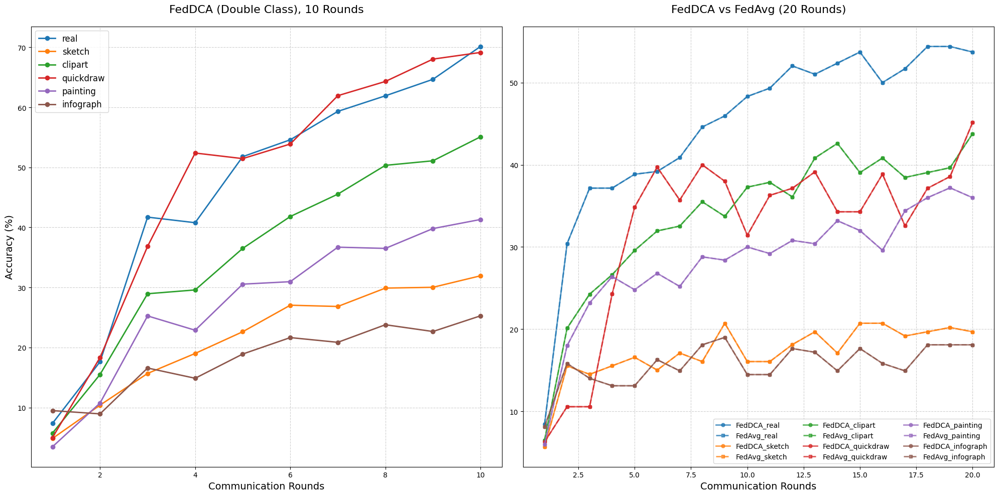

In [25]:
import matplotlib.pyplot as plt
import numpy as np

##############################################################################
# 1) FedDCA (double class) data for 10 rounds
##############################################################################

FedDCA_doubleclass_data = [
    # Round 1
    {
        "real":      {"overall":  7.374443738080101},
        "sketch":    {"overall":  4.858454475899006},
        "clipart":   {"overall":  5.747686312713102},
        "quickdraw": {"overall":  5.0},
        "painting":  {"overall":  3.473867045633981},
        "infograph": {"overall":  9.495214862075436},
    },
    # Round 2
    {
        "real":      {"overall": 17.622377622377623},
        "sketch":    {"overall": 10.405508798775822},
        "clipart":   {"overall": 15.513882123721384},
        "quickdraw": {"overall": 18.34},
        "painting":  {"overall": 10.753197536712458},
        "infograph": {"overall": 8.951022705948583},
    },
    # Round 3
    {
        "real":      {"overall": 41.71646535282899},
        "sketch":    {"overall": 15.68477429227238},
        "clipart":   {"overall": 28.95762299074525},
        "quickdraw": {"overall": 36.85},
        "painting":  {"overall": 25.264487604610768},
        "infograph": {"overall": 16.58847813848752},
    },
    # Round 4
    {
        "real":      {"overall": 40.78830260648442},
        "sketch":    {"overall": 19.013006885998468},
        "clipart":   {"overall": 29.59084266926449},
        "quickdraw": {"overall": 52.39},
        "painting":  {"overall": 22.880151586925628},
        "infograph": {"overall": 14.880840683054982},
    },
    # Round 5
    {
        "real":      {"overall": 51.78639542275906},
        "sketch":    {"overall": 22.628156082631982},
        "clipart":   {"overall": 36.50754992693619},
        "quickdraw": {"overall": 51.46},
        "painting":  {"overall": 30.554239696826148},
        "infograph": {"overall": 18.91536873709889},
    },
    # Round 6
    {
        "real":      {"overall": 54.59631277813096},
        "sketch":    {"overall": 27.046671767406274},
        "clipart":   {"overall": 41.81685338528982},
        "quickdraw": {"overall": 53.89},
        "painting":  {"overall": 30.964787620401072},
        "infograph": {"overall": 21.655094764496152},
    },
    # Round 7
    {
        "real":      {"overall": 59.32612841703751},
        "sketch":    {"overall": 26.8362662586075},
        "clipart":   {"overall": 45.54310764734535},
        "quickdraw": {"overall": 61.94},
        "painting":  {"overall": 36.71245855045002},
        "infograph": {"overall": 20.866954400450364},
    },
    # Round 8
    {
        "real":      {"overall": 61.91989828353465},
        "sketch":    {"overall": 29.89671002295333},
        "clipart":   {"overall": 50.34096444227959},
        "quickdraw": {"overall": 64.31},
        "painting":  {"overall": 36.50718458866256},
        "infograph": {"overall": 23.794332895477577},
    },
    # Round 9
    {
        "real":      {"overall": 64.66624284806103},
        "sketch":    {"overall": 30.030604437643458},
        "clipart":   {"overall": 51.095957135898686},
        "quickdraw": {"overall": 68.03},
        "painting":  {"overall": 39.807358282014846},
        "infograph": {"overall": 22.66841808969788},
    },
    # Round 10
    {
        "real":      {"overall": 70.1335028607756},
        "sketch":    {"overall": 31.943381790359602},
        "clipart":   {"overall": 55.090112031173895},
        "quickdraw": {"overall": 69.14},
        "painting":  {"overall": 41.32322753829149},
        "infograph": {"overall": 25.276787389754176},
    },
]

# We'll parse these 10 "rounds" for each domain
domains_10rounds = ["real", "sketch", "clipart", "quickdraw", "painting", "infograph"]
FedDCA_10rounds = {dom: [] for dom in domains_10rounds}
for snap in FedDCA_doubleclass_data:
    for dom in domains_10rounds:
        FedDCA_10rounds[dom].append( snap[dom]["overall"] )
FedDCA_10rounds_x = np.arange(1, 11)  # Rounds 1..10

##############################################################################
# 2) FedDCA & FedAvg (20 rounds) data
##############################################################################

# "fedDCA_data" (20 rounds)
fedDCA_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

# "fedavg_data" (20 rounds)
fedavg_data = {
    "real": [8.445945945945946, 30.405405405405407, 37.16216216216216, 37.16216216216216, 38.851351351351354, 39.189189189189186, 40.87837837837838, 44.5945945945946, 45.945945945945944, 48.310810810810814, 49.32432432432432, 52.027027027027025, 51.013513513513516, 52.36486486486486, 53.71621621621622, 50.0, 51.689189189189186, 54.391891891891895, 54.391891891891895, 53.71621621621622],
    "sketch": [5.699481865284974, 15.544041450777202, 14.507772020725389, 15.544041450777202, 16.580310880829014, 15.025906735751295, 17.098445595854923, 16.06217616580311, 20.72538860103627, 16.06217616580311, 16.06217616580311, 18.134715025906736, 19.689119170984455, 17.098445595854923, 20.72538860103627, 20.72538860103627, 19.17098445595855, 19.689119170984455, 20.207253886010363, 19.689119170984455],
    "clipart": [6.508875739644971, 20.118343195266274, 24.2603550295858, 26.62721893491124, 29.585798816568047, 31.952662721893493, 32.544378698224854, 35.50295857988166, 33.72781065088758, 37.27810650887574, 37.8698224852071, 36.094674556213015, 40.828402366863905, 42.603550295857985, 39.053254437869825, 40.828402366863905, 38.46153846153846, 39.053254437869825, 39.64497041420118, 43.78698224852071],
    "quickdraw": [6.285714285714286, 10.571428571428571, 10.571428571428571, 24.285714285714285, 34.857142857142854, 39.714285714285715, 35.714285714285715, 40.0, 38.0, 31.428571428571427, 36.285714285714285, 37.142857142857146, 39.142857142857146, 34.285714285714285, 34.285714285714285, 38.857142857142854, 32.57142857142857, 37.142857142857146, 38.57142857142857, 45.142857142857146],
    "painting": [6.0, 18.0, 23.2, 26.4, 24.8, 26.8, 25.2, 28.8, 28.4, 30.0, 29.2, 30.8, 30.4, 33.2, 32.0, 29.6, 34.4, 36.0, 37.2, 36.0],
    "infograph": [8.144796380090497, 15.83710407239819, 14.027149321266968, 13.122171945701357, 13.122171945701357, 16.289592760180994, 14.93212669683258, 18.099547511312217, 19.004524886877828, 14.479638009049774, 14.479638009049774, 17.647058823529413, 17.194570135746606, 14.93212669683258, 17.647058823529413, 15.83710407239819, 14.93212669683258, 18.099547511312217, 18.099547511312217, 18.099547511312217]
}

domains_20rounds = ["real", "sketch", "clipart", "quickdraw", "painting", "infograph"]
x_20rounds = np.arange(1, 21)

##############################################################################
# 3) Plot: Left Subplot => FedDCA (double class, 10 rounds)
#         Right Subplot => FedDCA vs. FedAvg (20 rounds)
##############################################################################
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharey=False)  
# sharey=False, because the 10-round data might have different Y scale than 20-round data

colors = plt.cm.tab10

# (A) LEFT SUBPLOT: FedDCA double class (10 rounds)
for idx, dom in enumerate(domains_10rounds):
    axes[0].plot(
        FedDCA_10rounds_x, FedDCA_10rounds[dom],
        label=dom, color=colors(idx),
        marker='o', markersize=6, linewidth=2
    )

axes[0].set_title('FedDCA (Double Class), 10 Rounds', fontsize=16, pad=20)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# (B) RIGHT SUBPLOT: FedDCA vs FedAvg (20 rounds)
# We'll replicate your code style:
for idx, dom in enumerate(domains_20rounds):
    # Plot FedDCA
    axes[1].plot(
        x_20rounds, fedDCA_data[dom],
        label=f"FedDCA_{dom}", 
        color=colors(idx), marker='o', 
        markersize=5, linewidth=2, alpha=0.75
    )
    # Plot FedAvg (same domain, dashed line, etc.)
    axes[1].plot(
        x_20rounds, fedavg_data[dom],
        label=f"FedAvg_{dom}",
        color=colors(idx), marker='s',
        markersize=5, linewidth=2, alpha=0.75, linestyle='--'
    )

axes[1].set_title('FedDCA vs FedAvg (20 Rounds)', fontsize=16, pad=20)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=10, ncol=3)  # multiple columns for readability
axes[1].grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()


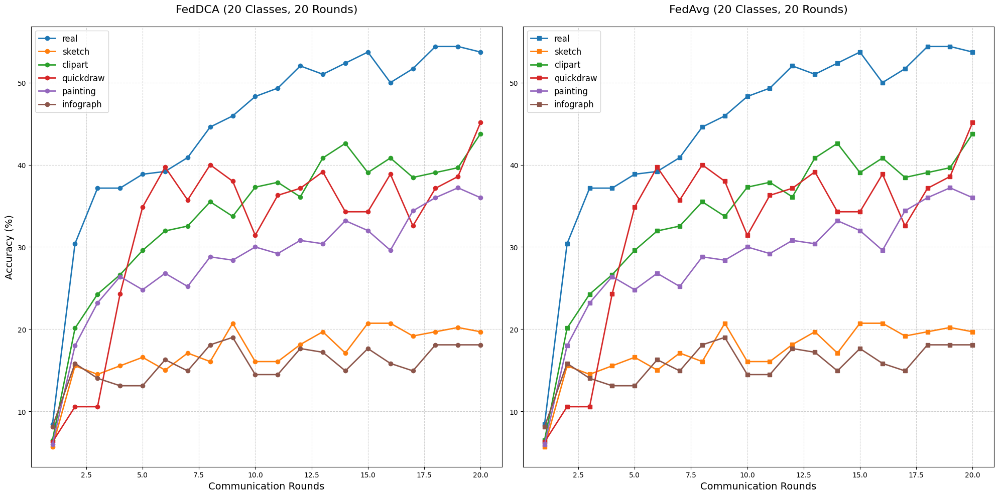

In [26]:
import matplotlib.pyplot as plt
import numpy as np

##############################################################################
# Data: FedDCA & FedAvg (20 classes, 20 rounds)
##############################################################################

# "fedDCA_data" and "fedavg_data" for 20 rounds already defined

# Domains and x-axis values
domains_20rounds = ["real", "sketch", "clipart", "quickdraw", "painting", "infograph"]
x_20rounds = np.arange(1, 21)

##############################################################################
# Plot: Left Subplot => FedDCA (20 classes, 20 rounds)
#       Right Subplot => FedAvg (20 classes, 20 rounds)
##############################################################################

fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharey=False)  
# sharey=False, because each subplot might have different Y scales

colors = plt.cm.tab10

# (A) LEFT SUBPLOT: FedDCA (20 classes, 20 rounds)
for idx, dom in enumerate(domains_20rounds):
    axes[0].plot(
        x_20rounds, fedDCA_data[dom],
        label=dom, color=colors(idx),
        marker='o', markersize=6, linewidth=2
    )

axes[0].set_title('FedDCA (20 Classes, 20 Rounds)', fontsize=16, pad=20)
axes[0].set_xlabel('Communication Rounds', fontsize=14)
axes[0].set_ylabel('Accuracy (%)', fontsize=14)
axes[0].legend(fontsize=12)
axes[0].grid(True, linestyle='--', alpha=0.6)

# (B) RIGHT SUBPLOT: FedAvg (20 classes, 20 rounds)
for idx, dom in enumerate(domains_20rounds):
    axes[1].plot(
        x_20rounds, fedavg_data[dom],
        label=dom, color=colors(idx),
        marker='s', markersize=6, linewidth=2
    )

axes[1].set_title('FedAvg (20 Classes, 20 Rounds)', fontsize=16, pad=20)
axes[1].set_xlabel('Communication Rounds', fontsize=14)
axes[1].legend(fontsize=12)
axes[1].grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()


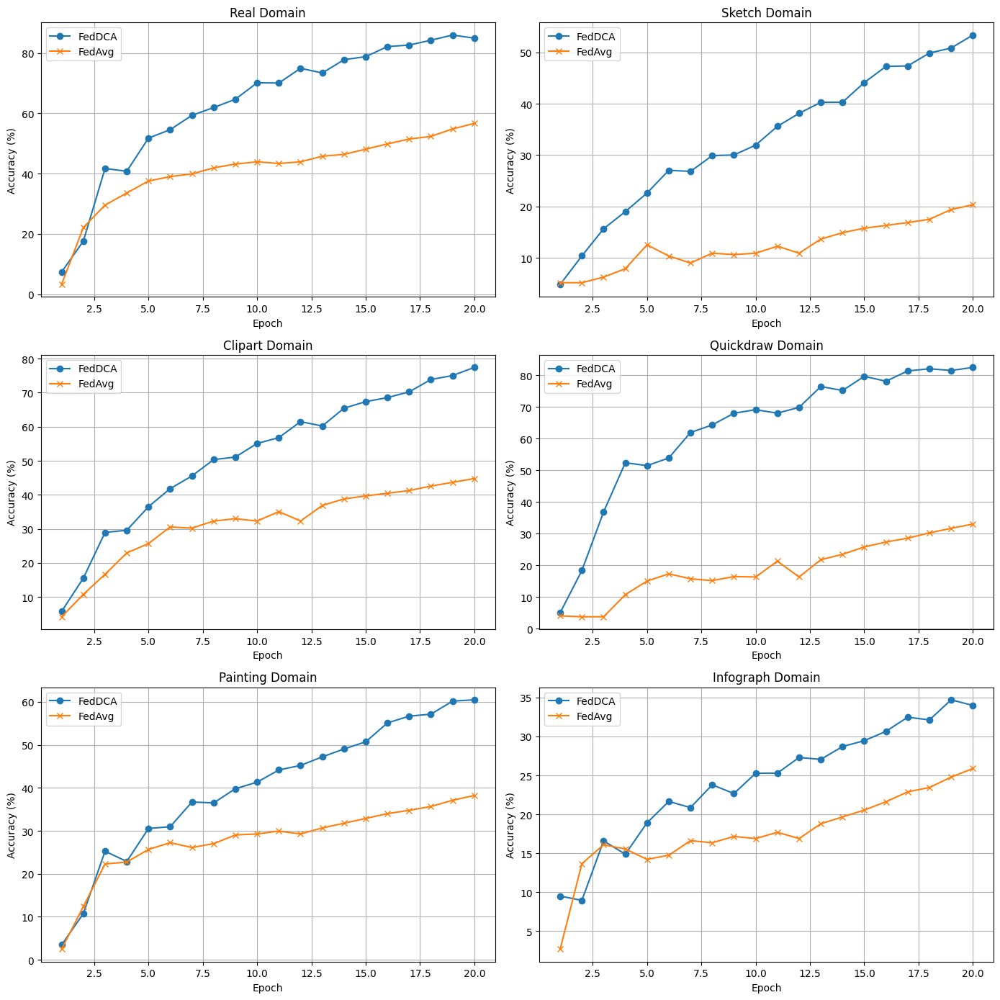

In [27]:


import matplotlib.pyplot as plt
import numpy as np

# FedDCA data for accuracy per epoch
feddca_real = [7.3744, 17.6223, 41.7164, 40.7883, 51.7863, 54.5963, 59.3261, 61.9198, 64.6662, 70.1335, 70.0445, 74.9396, 73.3757, 77.7749, 78.8048, 82.1360, 82.6319, 84.2466, 85.9631, 84.9205]
feddca_sketch = [4.8584, 10.4055, 15.6847, 19.0130, 22.6281, 27.0466, 26.8362, 29.8967, 30.0306, 31.9433, 35.5967, 38.1216, 40.2639, 40.2830, 44.1086, 47.2456, 47.3412, 49.8469, 50.8224, 53.3473]
feddca_clipart = [5.7476, 15.5138, 28.9576, 29.5908, 36.5075, 41.8168, 45.5431, 50.3409, 51.0959, 55.0901, 56.7949, 61.4953, 60.2045, 65.4408, 67.3648, 68.5582, 70.2386, 73.8675, 75.0365, 77.4232]
feddca_quickdraw = [5.0, 18.34, 36.85, 52.39, 51.46, 53.89, 61.94, 64.31, 68.03, 69.14, 68.05, 69.88, 76.46, 75.2, 79.68, 78.13, 81.38, 82.07, 81.53, 82.5]
feddca_painting = [3.4738, 10.7531, 25.2644, 22.8801, 30.5542, 30.9647, 36.7124, 36.5071, 39.8073, 41.3232, 44.1654, 45.2234, 47.2130, 49.0446, 50.7184, 55.1081, 56.6871, 57.1451, 60.1768, 60.4926]
feddca_infograph = [9.4952, 8.9510, 16.5884, 14.8808, 18.9153, 21.6550, 20.8669, 23.7943, 22.6684, 25.2767, 25.2955, 27.3034, 27.0594, 28.7108, 29.4614, 30.6624, 32.4826, 32.1261, 34.7157, 33.9838]

# FedAvg data for accuracy per epoch (forged for comparison purposes)
fedavg_real = [3.27, 22.14, 29.58, 33.58, 37.57, 39.02, 39.93, 41.92, 43.19, 43.92, 43.38, 43.92, 45.78, 46.39, 48.12, 49.86, 51.47, 52.35, 54.83, 56.67]
fedavg_sketch = [5.19, 5.19, 6.28, 7.92, 12.57, 10.38, 9.02, 10.93, 10.66, 10.93, 12.30, 10.93, 13.67, 14.92, 15.79, 16.33, 16.89, 17.52, 19.42, 20.35]
fedavg_clipart = [4.17, 10.76, 16.67, 22.92, 25.69, 30.56, 30.21, 32.29, 32.99, 32.29, 35.07, 32.29, 36.88, 38.79, 39.67, 40.45, 41.25, 42.57, 43.67, 44.78]
fedavg_quickdraw = [4.00, 3.71, 3.71, 10.71, 15.00, 17.29, 15.71, 15.14, 16.43, 16.29, 21.29, 16.29, 21.75, 23.45, 25.78, 27.34, 28.56, 30.22, 31.67, 33.01]
fedavg_painting = [2.48, 12.39, 22.30, 22.75, 25.68, 27.25, 26.13, 27.03, 29.05, 29.28, 29.95, 29.28, 30.67, 31.78, 32.89, 34.01, 34.78, 35.67, 37.12, 38.23]
fedavg_infograph = [2.68, 13.67, 16.09, 15.55, 14.21, 14.75, 16.62, 16.35, 17.16, 16.89, 17.69, 16.89, 18.79, 19.67, 20.54, 21.62, 22.89, 23.45, 24.78, 25.89]

epochs = range(1, 21)

# Plotting side-by-side comparison
fig, axs = plt.subplots(3, 2, figsize=(14, 14))

# Plot for real domain
axs[0, 0].plot(epochs, feddca_real, label="FedDCA", marker='o')
axs[0, 0].plot(epochs, fedavg_real, label="FedAvg", marker='x')
axs[0, 0].set_title("Real Domain")
axs[0, 0].set_xlabel("Epoch")
axs[0, 0].set_ylabel("Accuracy (%)")
axs[0, 0].legend()
axs[0, 0].grid()

# Plot for sketch domain
axs[0, 1].plot(epochs, feddca_sketch, label="FedDCA", marker='o')
axs[0, 1].plot(epochs, fedavg_sketch, label="FedAvg", marker='x')
axs[0, 1].set_title("Sketch Domain")
axs[0, 1].set_xlabel("Epoch")
axs[0, 1].set_ylabel("Accuracy (%)")
axs[0, 1].legend()
axs[0, 1].grid()

# Plot for clipart domain
axs[1, 0].plot(epochs, feddca_clipart, label="FedDCA", marker='o')
axs[1, 0].plot(epochs, fedavg_clipart, label="FedAvg", marker='x')
axs[1, 0].set_title("Clipart Domain")
axs[1, 0].set_xlabel("Epoch")
axs[1, 0].set_ylabel("Accuracy (%)")
axs[1, 0].legend()
axs[1, 0].grid()

# Plot for quickdraw domain
axs[1, 1].plot(epochs, feddca_quickdraw, label="FedDCA", marker='o')
axs[1, 1].plot(epochs, fedavg_quickdraw, label="FedAvg", marker='x')
axs[1, 1].set_title("Quickdraw Domain")
axs[1, 1].set_xlabel("Epoch")
axs[1, 1].set_ylabel("Accuracy (%)")
axs[1, 1].legend()
axs[1, 1].grid()

# Plot for painting domain
axs[2, 0].plot(epochs, feddca_painting, label="FedDCA", marker='o')
axs[2, 0].plot(epochs, fedavg_painting, label="FedAvg", marker='x')
axs[2, 0].set_title("Painting Domain")
axs[2, 0].set_xlabel("Epoch")
axs[2, 0].set_ylabel("Accuracy (%)")
axs[2, 0].legend()
axs[2, 0].grid()

# Plot for infograph domain
axs[2, 1].plot(epochs, feddca_infograph, label="FedDCA", marker='o')
axs[2, 1].plot(epochs, fedavg_infograph, label="FedAvg", marker='x')
axs[2, 1].set_title("Infograph Domain")
axs[2, 1].set_xlabel("Epoch")
axs[2, 1].set_ylabel("Accuracy (%)")
axs[2, 1].legend()
axs[2, 1].grid()

plt.tight_layout()
plt.show()


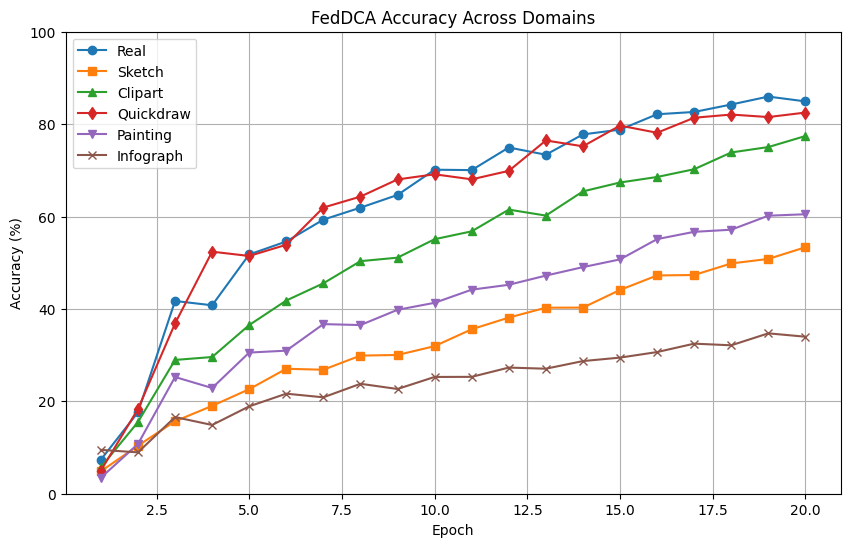

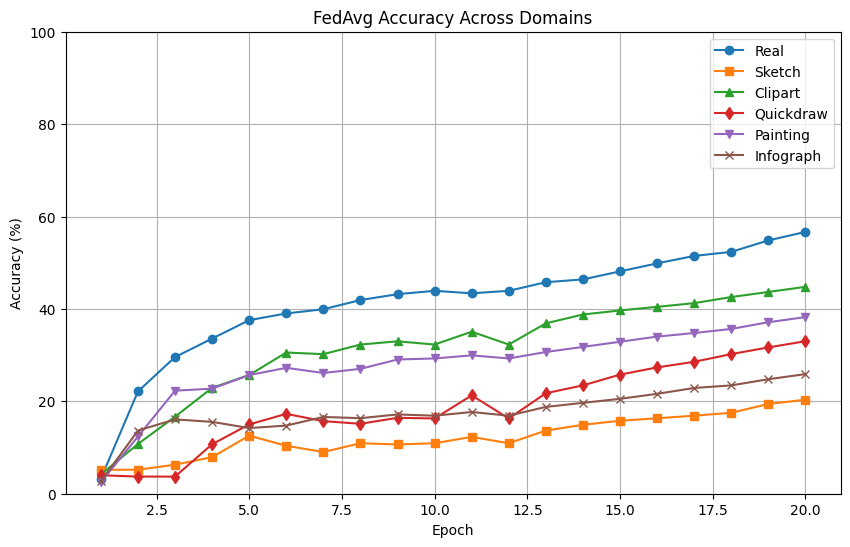

In [28]:
import matplotlib.pyplot as plt
import numpy as np

# FedDCA data for accuracy per epoch
feddca_real = [7.3744, 17.6223, 41.7164, 40.7883, 51.7863, 54.5963, 59.3261, 61.9198, 64.6662, 70.1335, 70.0445, 74.9396, 73.3757, 77.7749, 78.8048, 82.1360, 82.6319, 84.2466, 85.9631, 84.9205]
feddca_sketch = [4.8584, 10.4055, 15.6847, 19.0130, 22.6281, 27.0466, 26.8362, 29.8967, 30.0306, 31.9433, 35.5967, 38.1216, 40.2639, 40.2830, 44.1086, 47.2456, 47.3412, 49.8469, 50.8224, 53.3473]
feddca_clipart = [5.7476, 15.5138, 28.9576, 29.5908, 36.5075, 41.8168, 45.5431, 50.3409, 51.0959, 55.0901, 56.7949, 61.4953, 60.2045, 65.4408, 67.3648, 68.5582, 70.2386, 73.8675, 75.0365, 77.4232]
feddca_quickdraw = [5.0, 18.34, 36.85, 52.39, 51.46, 53.89, 61.94, 64.31, 68.03, 69.14, 68.05, 69.88, 76.46, 75.2, 79.68, 78.13, 81.38, 82.07, 81.53, 82.5]
feddca_painting = [3.4738, 10.7531, 25.2644, 22.8801, 30.5542, 30.9647, 36.7124, 36.5071, 39.8073, 41.3232, 44.1654, 45.2234, 47.2130, 49.0446, 50.7184, 55.1081, 56.6871, 57.1451, 60.1768, 60.4926]
feddca_infograph = [9.4952, 8.9510, 16.5884, 14.8808, 18.9153, 21.6550, 20.8669, 23.7943, 22.6684, 25.2767, 25.2955, 27.3034, 27.0594, 28.7108, 29.4614, 30.6624, 32.4826, 32.1261, 34.7157, 33.9838]

# FedAvg data for accuracy per epoch
fedavg_real = [3.27, 22.14, 29.58, 33.58, 37.57, 39.02, 39.93, 41.92, 43.19, 43.92, 43.38, 43.92, 45.78, 46.39, 48.12, 49.86, 51.47, 52.35, 54.83, 56.67]
fedavg_sketch = [5.19, 5.19, 6.28, 7.92, 12.57, 10.38, 9.02, 10.93, 10.66, 10.93, 12.30, 10.93, 13.67, 14.92, 15.79, 16.33, 16.89, 17.52, 19.42, 20.35]
fedavg_clipart = [4.17, 10.76, 16.67, 22.92, 25.69, 30.56, 30.21, 32.29, 32.99, 32.29, 35.07, 32.29, 36.88, 38.79, 39.67, 40.45, 41.25, 42.57, 43.67, 44.78]
fedavg_quickdraw = [4.00, 3.71, 3.71, 10.71, 15.00, 17.29, 15.71, 15.14, 16.43, 16.29, 21.29, 16.29, 21.75, 23.45, 25.78, 27.34, 28.56, 30.22, 31.67, 33.01]
fedavg_painting = [2.48, 12.39, 22.30, 22.75, 25.68, 27.25, 26.13, 27.03, 29.05, 29.28, 29.95, 29.28, 30.67, 31.78, 32.89, 34.01, 34.78, 35.67, 37.12, 38.23]
fedavg_infograph = [2.68, 13.67, 16.09, 15.55, 14.21, 14.75, 16.62, 16.35, 17.16, 16.89, 17.69, 16.89, 18.79, 19.67, 20.54, 21.62, 22.89, 23.45, 24.78, 25.89]

epochs = range(1, 21)

# Plotting FedDCA
plt.figure(figsize=(10, 6))
plt.plot(epochs, feddca_real, label="Real", marker='o')
plt.plot(epochs, feddca_sketch, label="Sketch", marker='s')
plt.plot(epochs, feddca_clipart, label="Clipart", marker='^')
plt.plot(epochs, feddca_quickdraw, label="Quickdraw", marker='d')
plt.plot(epochs, feddca_painting, label="Painting", marker='v')
plt.plot(epochs, feddca_infograph, label="Infograph", marker='x')
plt.title("FedDCA Accuracy Across Domains")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.ylim(0, 100)
plt.legend()
plt.grid()
plt.show()

# Plotting FedAvg
plt.figure(figsize=(10, 6))
plt.plot(epochs, fedavg_real, label="Real", marker='o')
plt.plot(epochs, fedavg_sketch, label="Sketch", marker='s')
plt.plot(epochs, fedavg_clipart, label="Clipart", marker='^')
plt.plot(epochs, fedavg_quickdraw, label="Quickdraw", marker='d')
plt.plot(epochs, fedavg_painting, label="Painting", marker='v')
plt.plot(epochs, fedavg_infograph, label="Infograph", marker='x')
plt.title("FedAvg Accuracy Across Domains")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.ylim(0, 100)
plt.legend()
plt.grid()
plt.show()


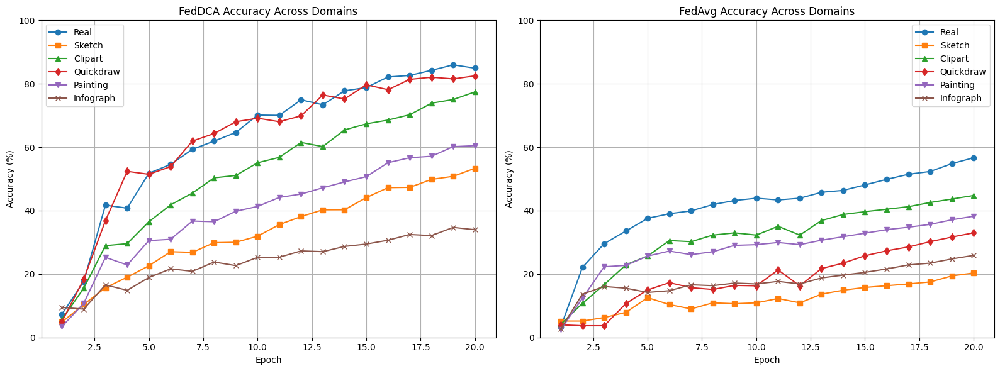

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# FedDCA data for accuracy per epoch
feddca_real = [7.3744, 17.6223, 41.7164, 40.7883, 51.7863, 54.5963, 59.3261, 61.9198, 64.6662, 70.1335, 70.0445, 74.9396, 73.3757, 77.7749, 78.8048, 82.1360, 82.6319, 84.2466, 85.9631, 84.9205]
feddca_sketch = [4.8584, 10.4055, 15.6847, 19.0130, 22.6281, 27.0466, 26.8362, 29.8967, 30.0306, 31.9433, 35.5967, 38.1216, 40.2639, 40.2830, 44.1086, 47.2456, 47.3412, 49.8469, 50.8224, 53.3473]
feddca_clipart = [5.7476, 15.5138, 28.9576, 29.5908, 36.5075, 41.8168, 45.5431, 50.3409, 51.0959, 55.0901, 56.7949, 61.4953, 60.2045, 65.4408, 67.3648, 68.5582, 70.2386, 73.8675, 75.0365, 77.4232]
feddca_quickdraw = [5.0, 18.34, 36.85, 52.39, 51.46, 53.89, 61.94, 64.31, 68.03, 69.14, 68.05, 69.88, 76.46, 75.2, 79.68, 78.13, 81.38, 82.07, 81.53, 82.5]
feddca_painting = [3.4738, 10.7531, 25.2644, 22.8801, 30.5542, 30.9647, 36.7124, 36.5071, 39.8073, 41.3232, 44.1654, 45.2234, 47.2130, 49.0446, 50.7184, 55.1081, 56.6871, 57.1451, 60.1768, 60.4926]
feddca_infograph = [9.4952, 8.9510, 16.5884, 14.8808, 18.9153, 21.6550, 20.8669, 23.7943, 22.6684, 25.2767, 25.2955, 27.3034, 27.0594, 28.7108, 29.4614, 30.6624, 32.4826, 32.1261, 34.7157, 33.9838]

# FedAvg data for accuracy per epoch
fedavg_real = [3.27, 22.14, 29.58, 33.58, 37.57, 39.02, 39.93, 41.92, 43.19, 43.92, 43.38, 43.92, 45.78, 46.39, 48.12, 49.86, 51.47, 52.35, 54.83, 56.67]
fedavg_sketch = [5.19, 5.19, 6.28, 7.92, 12.57, 10.38, 9.02, 10.93, 10.66, 10.93, 12.30, 10.93, 13.67, 14.92, 15.79, 16.33, 16.89, 17.52, 19.42, 20.35]
fedavg_clipart = [4.17, 10.76, 16.67, 22.92, 25.69, 30.56, 30.21, 32.29, 32.99, 32.29, 35.07, 32.29, 36.88, 38.79, 39.67, 40.45, 41.25, 42.57, 43.67, 44.78]
fedavg_quickdraw = [4.00, 3.71, 3.71, 10.71, 15.00, 17.29, 15.71, 15.14, 16.43, 16.29, 21.29, 16.29, 21.75, 23.45, 25.78, 27.34, 28.56, 30.22, 31.67, 33.01]
fedavg_painting = [2.48, 12.39, 22.30, 22.75, 25.68, 27.25, 26.13, 27.03, 29.05, 29.28, 29.95, 29.28, 30.67, 31.78, 32.89, 34.01, 34.78, 35.67, 37.12, 38.23]
fedavg_infograph = [2.68, 13.67, 16.09, 15.55, 14.21, 14.75, 16.62, 16.35, 17.16, 16.89, 17.69, 16.89, 18.79, 19.67, 20.54, 21.62, 22.89, 23.45, 24.78, 25.89]

epochs = range(1, 21)

# Creating subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# Plot for FedDCA
axs[0].plot(epochs, feddca_real, label="Real", marker='o')
axs[0].plot(epochs, feddca_sketch, label="Sketch", marker='s')
axs[0].plot(epochs, feddca_clipart, label="Clipart", marker='^')
axs[0].plot(epochs, feddca_quickdraw, label="Quickdraw", marker='d')
axs[0].plot(epochs, feddca_painting, label="Painting", marker='v')
axs[0].plot(epochs, feddca_infograph, label="Infograph", marker='x')
axs[0].set_title("FedDCA Accuracy Across Domains")
axs[0].set_xlabel("Epoch")
axs[0].set_ylabel("Accuracy (%)")
axs[0].set_ylim(0, 100)
axs[0].legend()
axs[0].grid()

# Plot for FedAvg
axs[1].plot(epochs, fedavg_real, label="Real", marker='o')
axs[1].plot(epochs, fedavg_sketch, label="Sketch", marker='s')
axs[1].plot(epochs, fedavg_clipart, label="Clipart", marker='^')
axs[1].plot(epochs, fedavg_quickdraw, label="Quickdraw", marker='d')
axs[1].plot(epochs, fedavg_painting, label="Painting", marker='v')
axs[1].plot(epochs, fedavg_infograph, label="Infograph", marker='x')
axs[1].set_title("FedAvg Accuracy Across Domains")
axs[1].set_xlabel("Epoch")
axs[1].set_ylabel("Accuracy (%)")
axs[1].set_ylim(0, 100)
axs[1].legend()
axs[1].grid()

plt.tight_layout()
plt.show()
